<center><p float="center">
  <img src="https://upload.wikimedia.org/wikipedia/commons/e/e9/4_RGB_McCombs_School_Brand_Branded.png" width="300" height="100"/>
  <img src="https://mma.prnewswire.com/media/1458111/Great_Learning_Logo.jpg?p=facebook" width="200" height="100"/>
</p></center>

<h1><center><font size=10>Data Science and Business Analytics</center></font></h1>
<h1><center>Renewable Energy Project</center></h1>


<center><img src="https://media.istockphoto.com/photos/aerial-view-of-wind-turbines-and-agriculture-field-picture-id1313977159?b=1&k=20&m=1313977159&s=170667a&w=0&h=ExclbR10buwemUV-gw3t3CbEkGYeo89jkmTtOO_cV5g=" width="800" height="500"></center>

<b><h2><center>ReneWind Energy</center></h2></b>

# Problem Statement

### Business Context

Renewable energy sources play an increasingly important role in the global energy mix, as the effort to reduce the environmental impact of energy production increases.

Out of all the renewable energy alternatives, wind energy is one of the most developed technologies worldwide. The U.S Department of Energy has put together a guide to achieving operational efficiency using predictive maintenance practices.

Predictive maintenance uses sensor information and analysis methods to measure and predict degradation and future component capability. The idea behind predictive maintenance is that failure patterns are predictable and if component failure can be predicted accurately and the component is replaced before it fails, the costs of operation and maintenance will be much lower.

The sensors fitted across different machines involved in the process of energy generation collect data related to various environmental factors (temperature, humidity, wind speed, etc.) and additional features related to various parts of the wind turbine (gearbox, tower, blades, break, etc.). 



## Objective
“ReneWind” is a company working on improving the machinery/processes involved in the production of wind energy using machine learning and has collected data of generator failure of wind turbines using sensors. They have shared a ciphered version of the data, as the data collected through sensors is confidential (the type of data collected varies with companies). Data has 40 predictors, 20000 observations in the training set and 5000 in the test set.

The objective is to build various classification models, tune them, and find the best one that will help identify failures so that the generators could be repaired before failing/breaking to reduce the overall maintenance cost. 
The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are failures correctly predicted by the model. These will result in repairing costs.
- False negatives (FN) are real failures where there is no detection by the model. These will result in replacement costs.
- False positives (FP) are detections where there is no failure. These will result in inspection costs.

It is given that the cost of repairing a generator is much less than the cost of replacing it, and the cost of inspection is less than the cost of repair.

“1” in the target variables should be considered as “failure” and “0” represents “No failure”.

## Data Description
- The data provided is a transformed version of original data which was collected using sensors.
- Train.csv - To be used for training and tuning of models. 
- Test.csv - To be used only for testing the performance of the final best model.
- Both the datasets consist of 40 predictor variables and 1 target variable

## Imblearn installation

In [278]:
# Imblearn libary is used to handle imbalanced data

# Jupyter notebook
!pip install imblearn --user

!pip install imbalanced-learn --user

# Anaconda prompt
#!pip install -U imbalanced-learn

#conda install -c conda-forge imbalanced-learn

# Restart the kernel after successful installation of the library

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Importing necessary libraries

In [279]:
# To help with reading and manipulating data
import pandas as pd
import numpy as np

# To help with data visualization
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

# To be used for missing value imputation
from sklearn.impute import SimpleImputer, KNNImputer

# Removes the limit for the number of displayed columns
pd.set_option("display.max_columns", None)

# Sets the limit for the number of displayed rows
pd.set_option("display.max_rows", 200)

# setting the precision of floating numbers to 2 decimal points
pd.set_option("display.float_format", lambda x: "%.2f" % x)

# To help with model building
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (
    AdaBoostClassifier,
    GradientBoostingClassifier,
    RandomForestClassifier,
    BaggingClassifier,
)
from xgboost import XGBClassifier

# To get different metric scores, and split data
from sklearn import metrics
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.metrics import (
    f1_score,
    accuracy_score,
    recall_score,
    precision_score,
    confusion_matrix,
    roc_auc_score,
    plot_confusion_matrix,
    precision_recall_curve,
    roc_curve,
    make_scorer,
)

# To be used for data scaling and one hot encoding
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder

# To be used for tuning the model
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

# To be used for creating pipelines and personalizing them
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer

# to use standard scaler
from sklearn.preprocessing import StandardScaler

# To undersample and oversample the data
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# To supress warnings
import warnings

warnings.filterwarnings("ignore")
from statsmodels.tools.sm_exceptions import ConvergenceWarning

warnings.simplefilter("ignore", ConvergenceWarning)

## Loading the dataset

In [280]:
train_data = pd.read_csv("/content/Train.csv.csv")
test_data = pd.read_csv("/content/Test.csv.csv")

In [281]:
train_data.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-4.46,-4.68,3.10,0.51,-0.22,-2.03,-2.91,0.05,-1.52,3.76,-5.71,0.74,0.98,1.42,-3.38,-3.05,0.31,2.91,2.27,4.39,-2.39,0.65,-1.19,3.13,0.67,-2.51,-0.04,0.73,-3.98,-1.07,1.67,3.06,-1.69,2.85,2.24,6.67,0.44,-2.37,2.95,-3.48,0
1,3.37,3.65,0.91,-1.37,0.33,2.36,0.73,-4.33,0.57,-0.10,1.91,-0.95,-1.26,-2.71,0.19,-4.77,-2.21,0.91,0.76,-5.83,-3.07,1.60,-1.76,1.77,-0.27,3.63,1.50,-0.59,0.78,-0.20,0.02,-1.80,3.03,-2.47,1.89,-2.30,-1.73,5.91,-0.39,0.62,0
2,-3.83,-5.82,0.63,-2.42,-1.77,1.02,-2.10,-3.17,-2.08,5.39,-0.77,1.11,1.14,0.94,-3.16,-4.25,-4.04,3.69,3.31,1.06,-2.14,1.65,-1.66,1.68,-0.45,-4.55,3.74,1.13,-2.03,0.84,-1.60,-0.26,0.80,4.09,2.29,5.36,0.35,2.94,3.84,-4.31,0
3,1.62,1.89,7.05,-1.15,0.08,-1.53,0.21,-2.49,0.34,2.12,-3.05,0.46,2.70,-0.64,-0.45,-3.17,-3.40,-1.28,1.58,-1.95,-3.52,-1.21,-5.63,-1.82,2.12,5.29,4.75,-2.31,-3.96,-6.03,4.95,-3.58,-2.58,1.36,0.62,5.55,-1.53,0.14,3.10,-1.28,0
4,-0.11,3.87,-3.76,-2.98,3.79,0.54,0.21,4.85,-1.85,-6.22,2.00,4.72,0.71,-1.99,-2.63,4.18,2.25,3.73,-6.31,-5.38,-0.89,2.06,9.45,4.49,-3.95,4.58,-8.78,-3.38,5.11,6.79,2.04,8.27,6.63,-10.07,1.22,-3.23,1.69,-2.16,-3.64,6.51,0


* All the columns are ciphered or coded. It is difficult to interpret what the figures mean and to properly understand potential outliers or input errors

In [282]:
test_data.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-0.61,-3.82,2.20,1.30,-1.18,-4.50,-1.84,4.72,1.21,-0.34,-5.12,1.02,4.82,3.27,-2.98,1.39,2.03,-0.51,-1.02,7.34,-2.24,0.16,2.05,-2.77,1.85,-1.79,-0.28,-1.26,-3.83,-1.50,1.59,2.29,-5.41,0.87,0.57,4.16,1.43,-10.51,0.45,-1.45,0
1,0.39,-0.51,0.53,-2.58,-1.02,2.24,-0.44,-4.41,-0.33,1.97,1.80,0.41,0.64,-1.39,-1.88,-5.02,-3.83,2.42,1.76,-3.24,-3.19,1.86,-1.71,0.63,-0.59,0.08,3.01,-0.18,0.22,0.87,-1.78,-2.47,2.49,0.32,2.06,0.68,-0.49,5.13,1.72,-1.49,0
2,-0.87,-0.64,4.08,-1.59,0.53,-1.96,-0.70,1.35,-1.73,0.47,-4.93,3.57,-0.45,-0.66,-0.17,-1.63,2.29,2.40,0.60,1.79,-2.12,0.48,-0.84,1.79,1.87,0.36,-0.17,-0.48,-2.12,-2.16,2.91,-1.32,-3.00,0.46,0.62,5.63,1.32,-1.75,1.81,1.68,0
3,0.24,1.46,4.01,2.53,1.20,-3.12,-0.92,0.27,1.32,0.70,-5.58,-0.85,2.59,0.77,-2.39,-2.34,0.57,-0.93,0.51,1.21,-3.26,0.10,-0.66,1.50,1.10,4.14,-0.25,-1.14,-5.36,-4.55,3.81,3.52,-3.07,-0.28,0.95,3.03,-1.37,-3.41,0.91,-2.45,0
4,5.83,2.77,-1.23,2.81,-1.64,-1.41,0.57,0.97,1.92,-2.77,-0.53,1.37,-0.65,-1.68,-0.38,-4.44,3.89,-0.61,2.94,0.37,-5.79,4.60,4.45,3.22,0.40,0.25,-2.36,1.08,-0.47,2.24,-3.59,1.77,-1.50,-2.23,4.78,-6.56,-0.81,-0.28,-3.86,-0.54,0


* All the columns are ciphered or coded. It is difficult to interpret what the figures mean and to properly understand potential outliers or input errors

In [283]:
df = train_data.copy()
df.head(3)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-4.46,-4.68,3.10,0.51,-0.22,-2.03,-2.91,0.05,-1.52,3.76,-5.71,0.74,0.98,1.42,-3.38,-3.05,0.31,2.91,2.27,4.39,-2.39,0.65,-1.19,3.13,0.67,-2.51,-0.04,0.73,-3.98,-1.07,1.67,3.06,-1.69,2.85,2.24,6.67,0.44,-2.37,2.95,-3.48,0
1,3.37,3.65,0.91,-1.37,0.33,2.36,0.73,-4.33,0.57,-0.10,1.91,-0.95,-1.26,-2.71,0.19,-4.77,-2.21,0.91,0.76,-5.83,-3.07,1.60,-1.76,1.77,-0.27,3.63,1.50,-0.59,0.78,-0.20,0.02,-1.80,3.03,-2.47,1.89,-2.30,-1.73,5.91,-0.39,0.62,0
2,-3.83,-5.82,0.63,-2.42,-1.77,1.02,-2.10,-3.17,-2.08,5.39,-0.77,1.11,1.14,0.94,-3.16,-4.25,-4.04,3.69,3.31,1.06,-2.14,1.65,-1.66,1.68,-0.45,-4.55,3.74,1.13,-2.03,0.84,-1.60,-0.26,0.80,4.09,2.29,5.36,0.35,2.94,3.84,-4.31,0


## Data Overview

- Observations
- Sanity checks

In [284]:
df.shape

(20000, 41)

* There are 41 features and 20,000 observations in the data

In [285]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 41 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      19982 non-null  float64
 1   V2      19982 non-null  float64
 2   V3      20000 non-null  float64
 3   V4      20000 non-null  float64
 4   V5      20000 non-null  float64
 5   V6      20000 non-null  float64
 6   V7      20000 non-null  float64
 7   V8      20000 non-null  float64
 8   V9      20000 non-null  float64
 9   V10     20000 non-null  float64
 10  V11     20000 non-null  float64
 11  V12     20000 non-null  float64
 12  V13     20000 non-null  float64
 13  V14     20000 non-null  float64
 14  V15     20000 non-null  float64
 15  V16     20000 non-null  float64
 16  V17     20000 non-null  float64
 17  V18     20000 non-null  float64
 18  V19     20000 non-null  float64
 19  V20     20000 non-null  float64
 20  V21     20000 non-null  float64
 21  V22     20000 non-null  float64
 22

* All the columns are numerical 
* The first 2 columns appear to have missing data
* All the columns are ciphered or coded. It is difficult to interpret what the figures mean and to properly understand potential outliers or input errors
* The target variable is returned as numerical instead of categorical

In [286]:
df.duplicated().sum()

0

* There are no duplicated observations 

In [287]:
df.isnull().sum()

V1        18
V2        18
V3         0
V4         0
V5         0
V6         0
V7         0
V8         0
V9         0
V10        0
V11        0
V12        0
V13        0
V14        0
V15        0
V16        0
V17        0
V18        0
V19        0
V20        0
V21        0
V22        0
V23        0
V24        0
V25        0
V26        0
V27        0
V28        0
V29        0
V30        0
V31        0
V32        0
V33        0
V34        0
V35        0
V36        0
V37        0
V38        0
V39        0
V40        0
Target     0
dtype: int64

* The first and the second both have 18 values missing

In [288]:
df[df['V1'].isnull()==True]

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
89,NaN,-3.96,2.79,-4.71,-3.01,-1.54,-0.88,1.48,0.57,-1.10,-1.85,4.54,4.49,0.71,-2.14,-2.03,0.14,2.79,-1.17,4.87,-3.92,1.49,-0.17,-6.47,3.01,-3.13,3.96,-1.90,-0.64,-0.54,-1.88,-8.33,-5.14,1.12,-0.31,5.32,3.75,-5.63,2.37,2.20,0
5941,NaN,1.01,1.23,5.40,0.06,-2.71,-2.03,0.53,3.01,-2.36,-5.71,-1.62,-0.05,-0.51,-3.03,-5.00,6.43,0.77,1.24,5.86,-3.85,1.71,1.02,2.31,1.16,0.39,-4.91,1.45,-2.54,-0.52,-2.75,1.87,-3.12,-0.55,1.71,-2.26,0.41,-3.43,-1.30,-1.77,0
6317,NaN,-5.21,2.00,-3.71,-1.04,-1.59,-2.65,0.85,-1.31,2.41,-2.70,3.52,6.08,1.89,-6.30,-2.35,-3.71,4.06,-0.37,1.62,-5.27,2.43,2.35,0.06,-0.47,-1.31,1.87,-2.45,-2.91,1.17,1.49,3.07,-0.07,-0.28,3.20,7.02,1.30,-4.58,2.96,-2.36,0
6464,NaN,2.15,5.00,4.19,1.43,-6.44,-0.93,3.79,-0.68,-0.74,-8.19,6.68,4.11,-0.65,-4.76,-1.71,4.04,-0.46,4.03,3.83,-5.31,0.93,2.93,4.46,-0.35,4.86,-5.04,-0.77,-5.67,-2.64,1.85,5.23,-5.11,1.75,2.59,3.99,0.61,-4.27,1.86,-3.60,0
7073,NaN,2.53,2.76,-1.67,-1.94,-0.03,0.91,-3.20,2.95,-0.41,0.01,-0.48,2.91,-0.94,-0.65,-6.15,-2.60,-0.67,0.77,-2.70,-6.40,2.86,-1.41,-2.86,2.36,3.17,5.59,-1.77,-2.73,-3.30,-0.20,-4.89,-2.61,-1.50,2.04,-0.83,-1.37,0.57,-0.13,-0.32,0
8431,NaN,-1.40,-2.01,-1.75,0.93,-1.29,-0.27,4.46,-2.78,-1.21,-2.05,5.28,-0.87,0.07,-0.67,1.87,3.44,3.30,-0.93,0.94,-0.56,2.55,6.47,4.47,-0.81,-2.22,-3.84,0.17,0.23,2.96,0.42,4.56,-0.42,-2.04,1.11,1.52,2.11,-2.25,-0.94,2.54,0
8439,NaN,-3.84,0.20,4.15,1.15,-0.99,-4.73,0.56,-0.93,0.46,-4.89,-1.25,-1.65,-0.23,-5.41,-2.99,4.83,4.64,1.30,6.40,-1.09,0.13,0.41,6.21,-1.94,-3.00,-8.53,2.12,0.82,4.87,-2.01,6.82,3.45,0.24,3.22,1.20,1.27,-1.92,0.58,-2.84,0
11156,NaN,-0.67,3.72,4.93,1.67,-4.36,-2.82,0.37,-0.71,2.18,-8.81,2.56,1.96,0.00,-5.94,-4.68,3.29,1.98,4.43,4.71,-4.12,1.05,0.86,6.75,-0.81,1.88,-4.79,1.25,-6.28,-2.25,0.46,6.66,-2.90,3.07,2.49,4.81,0.07,-1.22,3.01,-5.97,0
11287,NaN,-2.56,-0.18,-7.19,-1.04,1.38,1.31,1.56,-2.99,1.27,3.03,3.69,0.52,0.75,2.46,3.19,-4.05,1.52,-2.11,-3.49,0.55,0.76,1.15,-2.13,0.73,-2.17,5.07,-2.04,1.56,0.86,3.19,-2.53,0.56,-1.15,-0.02,4.07,0.98,-0.57,0.63,3.92,0
11456,NaN,1.30,4.38,1.58,-0.08,0.66,-1.64,-4.81,-0.91,2.81,0.57,-0.32,0.85,-2.78,-3.63,-5.40,-4.24,0.26,5.22,-3.45,-4.54,-0.52,-5.11,3.63,-2.31,4.27,-0.81,-0.53,0.69,1.79,0.72,1.77,5.76,1.20,5.66,0.41,-2.64,5.53,2.10,-4.95,0


In [289]:
df[df['V2'].isnull()==True]

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
613,-2.05,NaN,-1.62,-3.32,0.15,0.60,-1.81,0.85,-1.52,0.21,-0.46,2.38,1.68,0.53,-3.77,-1.10,-0.79,4.86,-1.96,0.05,-2.20,2.57,3.99,2.07,-1.31,-2.23,-1.32,-0.93,0.54,3.59,-0.47,3.26,2.38,-2.46,1.72,2.54,1.70,-1.43,0.60,0.74,0
2236,-3.76,NaN,0.19,-1.64,1.26,-1.57,-3.69,1.58,-0.31,-0.14,-4.50,1.82,5.03,1.44,-8.11,-2.80,-0.19,5.80,-3.03,2.02,-5.08,3.03,5.20,3.12,-1.58,0.26,-3.54,-2.27,-2.47,2.47,1.16,7.62,1.70,-3.96,2.71,4.66,1.62,-5.54,1.25,-1.16,0
2508,-1.43,NaN,0.66,-2.88,1.15,-0.79,-1.56,2.90,-2.35,-0.22,-1.13,2.93,2.05,0.38,-3.12,1.32,-1.05,3.19,-2.29,-1.31,-2.46,1.29,3.69,3.00,-1.52,0.90,-2.65,-2.50,0.68,3.29,3.92,6.28,3.32,-4.05,3.12,3.34,0.60,-3.78,-0.16,1.50,0
4653,5.47,NaN,4.54,-2.92,0.40,2.80,0.03,-7.33,1.12,1.70,1.16,-2.78,0.57,-3.08,-1.39,-8.51,-6.21,1.40,0.77,-9.15,-6.87,2.07,-4.81,1.90,0.34,7.16,4.65,-2.62,-1.11,-2.28,3.65,-1.54,4.60,-4.10,4.30,0.15,-3.73,6.56,0.71,-0.46,0
6810,-2.63,NaN,2.33,1.09,0.60,-1.14,-0.69,-1.36,0.36,-1.19,-1.70,3.14,2.52,-2.17,-3.98,-3.46,0.50,1.16,1.97,0.02,-3.50,0.38,-0.34,0.91,-1.20,3.69,-2.56,-0.73,-0.45,0.17,-1.96,-0.95,0.21,0.45,1.05,0.54,0.76,1.73,1.89,-1.70,0
7788,-4.20,NaN,2.95,0.58,4.10,-0.64,-2.81,-0.11,-1.36,-0.80,-1.39,0.42,3.81,-1.78,-7.55,-1.17,-3.18,2.58,-1.86,-5.78,-4.96,-0.05,1.94,6.76,-4.83,9.17,-7.40,-4.28,0.95,3.96,6.19,12.52,9.50,-7.15,5.67,1.25,-2.16,-0.95,-0.00,-1.55,0
8483,-4.48,NaN,1.20,-2.04,2.78,-0.80,-5.40,-1.23,1.49,-0.97,-5.91,-0.33,7.56,0.80,-12.69,-7.01,-1.56,8.51,-5.54,0.20,-8.39,4.01,5.07,3.77,-2.40,4.07,-4.74,-4.10,-3.46,2.15,1.66,9.47,4.28,-7.59,3.27,5.23,1.28,-5.37,1.98,-1.64,0
8894,3.26,NaN,8.45,-3.25,-3.42,-3.00,-0.67,-0.16,-0.67,3.13,-2.11,3.73,5.75,0.33,-1.83,-3.28,-5.36,-1.13,3.78,0.58,-7.45,0.40,-4.71,-3.82,2.68,1.78,7.03,-3.36,-3.22,-2.71,4.55,-4.24,-3.12,2.52,5.28,7.29,-0.87,-4.32,3.12,-2.39,0
8947,-3.79,NaN,0.72,2.31,0.93,-0.98,0.50,-0.44,-2.77,1.73,-1.99,4.21,-2.80,-2.08,0.34,-1.37,2.09,0.31,5.49,-0.39,0.09,0.33,0.12,6.04,-1.38,0.37,-2.73,2.51,-1.07,-0.05,-1.29,1.53,-0.50,3.79,1.13,0.62,-0.11,5.71,1.54,-2.48,0
9362,2.66,NaN,2.98,4.43,-0.24,0.67,0.38,-7.65,4.43,-0.75,-1.17,-3.07,0.03,-3.77,-1.93,-10.30,0.34,-1.31,4.46,-2.18,-5.36,1.26,-5.03,0.45,0.70,6.00,0.91,1.18,-2.53,-4.02,-4.61,-5.49,-1.10,1.22,0.98,-4.79,-2.27,7.67,0.82,-3.93,0


* There is no row or observation with more than 1 missing values
* Missing values will be treated later

In [290]:
df.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
count,19982.00,19982.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00,20000.00
mean,-0.27,0.44,2.48,-0.08,-0.05,-1.00,-0.88,-0.55,-0.02,-0.01,-1.90,1.60,1.58,-0.95,-2.41,-2.93,-0.13,1.19,1.18,0.02,-3.61,0.95,-0.37,1.13,-0.00,1.87,-0.61,-0.88,-0.99,-0.02,0.49,0.30,0.05,-0.46,2.23,1.51,0.01,-0.34,0.89,-0.88,0.06
std,3.44,3.15,3.39,3.43,2.10,2.04,1.76,3.30,2.16,2.19,3.12,2.93,2.87,1.79,3.35,4.22,3.35,2.59,3.40,3.67,3.57,1.65,4.03,3.91,2.02,3.44,4.37,1.92,2.68,3.01,3.46,5.50,3.58,3.18,2.94,3.80,1.79,3.95,1.75,3.01,0.23
min,-11.88,-12.32,-10.71,-15.08,-8.60,-10.23,-7.95,-15.66,-8.60,-9.85,-14.83,-12.95,-13.23,-7.74,-16.42,-20.37,-14.09,-11.64,-13.49,-13.92,-17.96,-10.12,-14.87,-16.39,-8.23,-11.83,-14.90,-9.27,-12.58,-14.80,-13.72,-19.88,-16.90,-17.99,-15.35,-14.83,-5.48,-17.38,-6.44,-11.02,0.00
25%,-2.74,-1.64,0.21,-2.35,-1.54,-2.35,-2.03,-2.64,-1.49,-1.41,-3.92,-0.40,-0.22,-2.17,-4.42,-5.63,-2.22,-0.40,-1.05,-2.43,-5.93,-0.12,-3.10,-1.47,-1.37,-0.34,-3.65,-2.17,-2.79,-1.87,-1.82,-3.42,-2.24,-2.14,0.34,-0.94,-1.26,-2.99,-0.27,-2.94,0.00
50%,-0.75,0.47,2.26,-0.14,-0.10,-1.00,-0.92,-0.39,-0.07,0.10,-1.92,1.51,1.64,-0.96,-2.38,-2.68,-0.01,0.88,1.28,0.03,-3.53,0.97,-0.26,0.97,0.03,1.95,-0.88,-0.89,-1.18,0.18,0.49,0.05,-0.07,-0.26,2.10,1.57,-0.13,-0.32,0.92,-0.92,0.00
75%,1.84,2.54,4.57,2.13,1.34,0.38,0.22,1.72,1.41,1.48,0.12,3.57,3.46,0.27,-0.36,-0.10,2.07,2.57,3.49,2.51,-1.27,2.03,2.45,3.55,1.40,4.13,2.19,0.38,0.63,2.04,2.73,3.76,2.26,1.44,4.06,3.98,1.18,2.28,2.06,1.12,0.00
max,15.49,13.09,17.09,13.24,8.13,6.98,8.01,11.68,8.14,8.11,11.83,15.08,15.42,5.67,12.25,13.58,16.76,13.18,13.24,16.05,13.84,7.41,14.46,17.16,8.22,16.84,17.56,6.53,10.72,12.51,17.26,23.63,16.69,14.36,15.29,19.33,7.47,15.29,7.76,10.65,1.00


* The minimum values of each feature is a negative float figure while the maximum values are positive
* The data appears to be normally distrubuted for most of the features 
* For most of the features except V3, V15, V16,V35 the mean and median for most of the features range between -1.92 and 1.95


## Exploratory Data Analysis (EDA)

### Plotting histograms and boxplots for all the variables

### Univariate Analysis

In [291]:
# function to plot a boxplot and a histogram along the same scale.


def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to the show density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, palette="winter"
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram

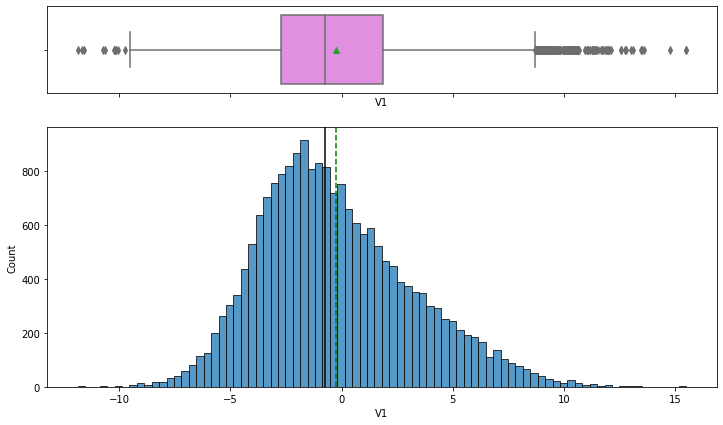

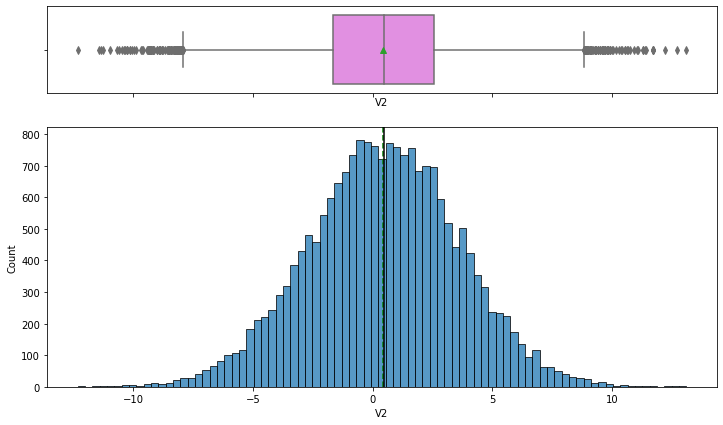

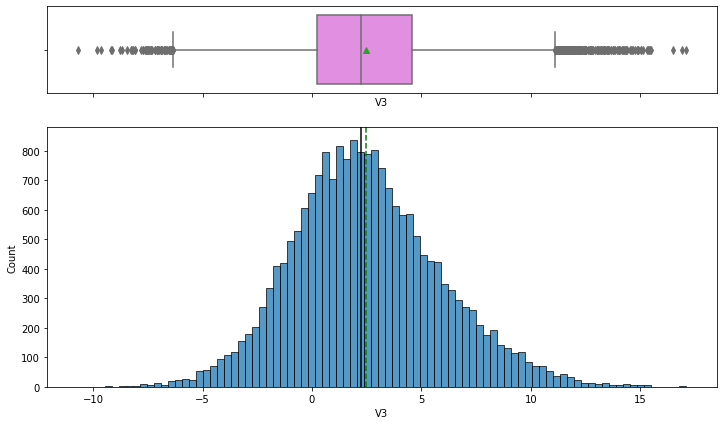

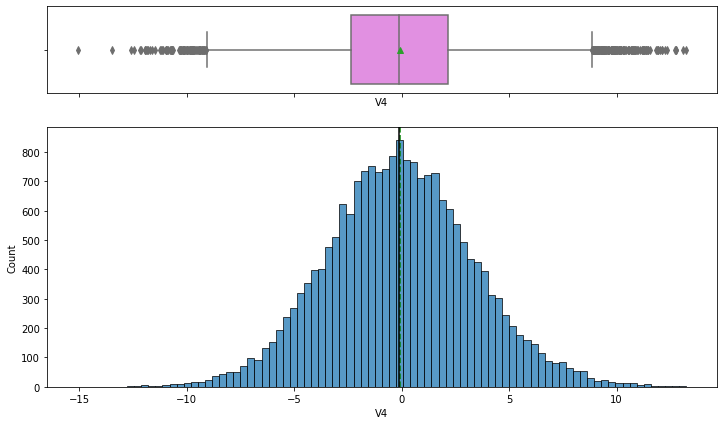

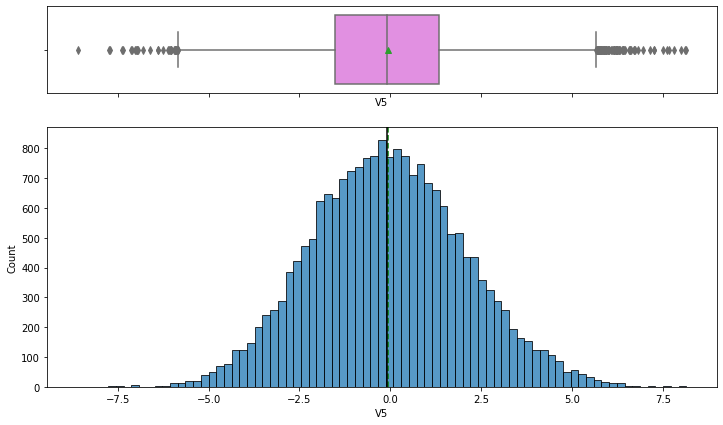

...

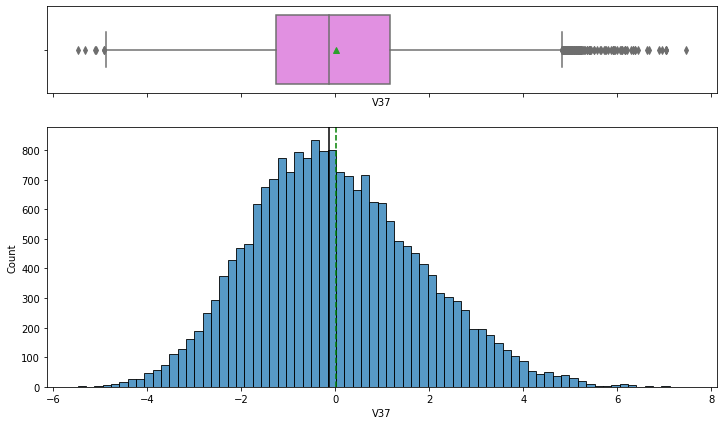

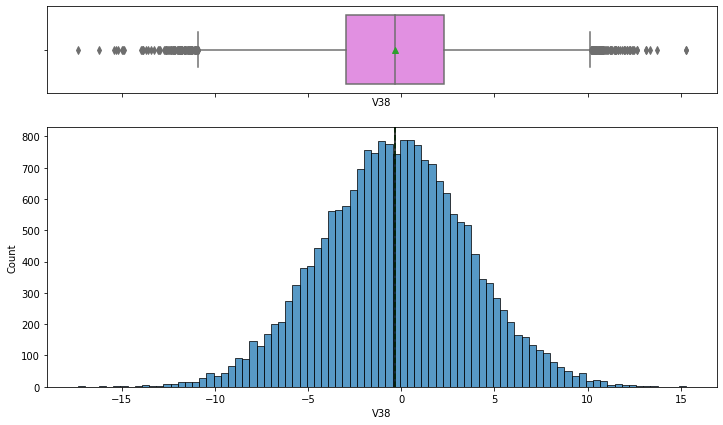

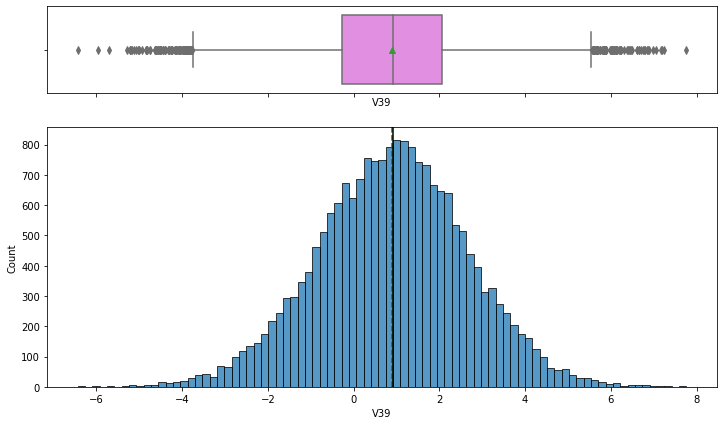

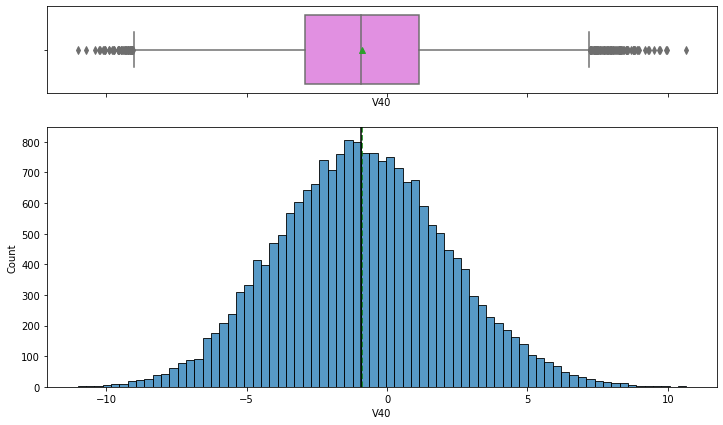

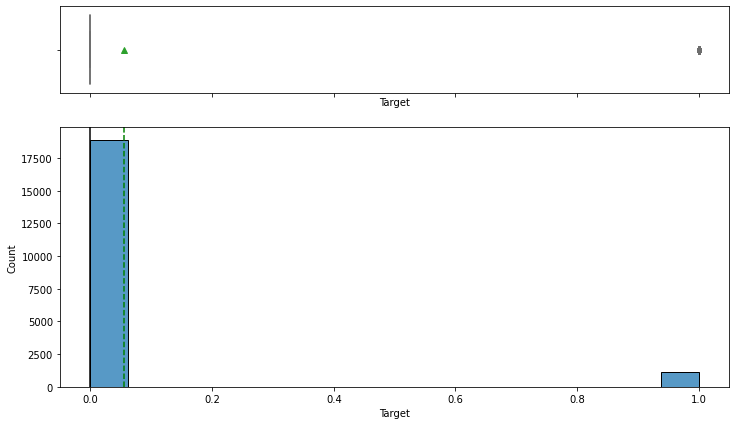

In [292]:
for feature in df.columns:
    histogram_boxplot(df, feature, figsize=(12, 7), kde=False, bins=None) ## Please change the dataframe name as you define while reading the data

* As observed earlier, all the features except the target feature appears to be normally distribution with some having very slight skewness

* The target variable is categorical with the data highly imbalanced

### Bivariate Analysis ###

In [293]:
df_1 = df.iloc[:,0:11]
df_1['Target'] = df['Target']
df_1

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,Target
0,-4.46,-4.68,3.10,0.51,-0.22,-2.03,-2.91,0.05,-1.52,3.76,-5.71,0
1,3.37,3.65,0.91,-1.37,0.33,2.36,0.73,-4.33,0.57,-0.10,1.91,0
2,-3.83,-5.82,0.63,-2.42,-1.77,1.02,-2.10,-3.17,-2.08,5.39,-0.77,0
3,1.62,1.89,7.05,-1.15,0.08,-1.53,0.21,-2.49,0.34,2.12,-3.05,0
4,-0.11,3.87,-3.76,-2.98,3.79,0.54,0.21,4.85,-1.85,-6.22,2.00,0
...,...,...,...,...,...,...,...,...,...,...,...,...
19995,-2.07,-1.09,-0.80,-3.01,-2.29,2.81,0.48,0.11,-0.59,-2.90,8.87,1
19996,2.89,2.48,5.64,0.94,-1.38,0.41,-1.59,-5.76,2.15,0.27,-2.09,0
19997,-3.90,-3.94,-0.35,-2.42,1.11,-1.53,-3.52,2.05,-0.23,-0.36,-3.78,0
19998,-3.19,-10.05,5.70,-4.37,-5.35,-1.87,-3.95,0.68,-2.39,5.46,1.58,0


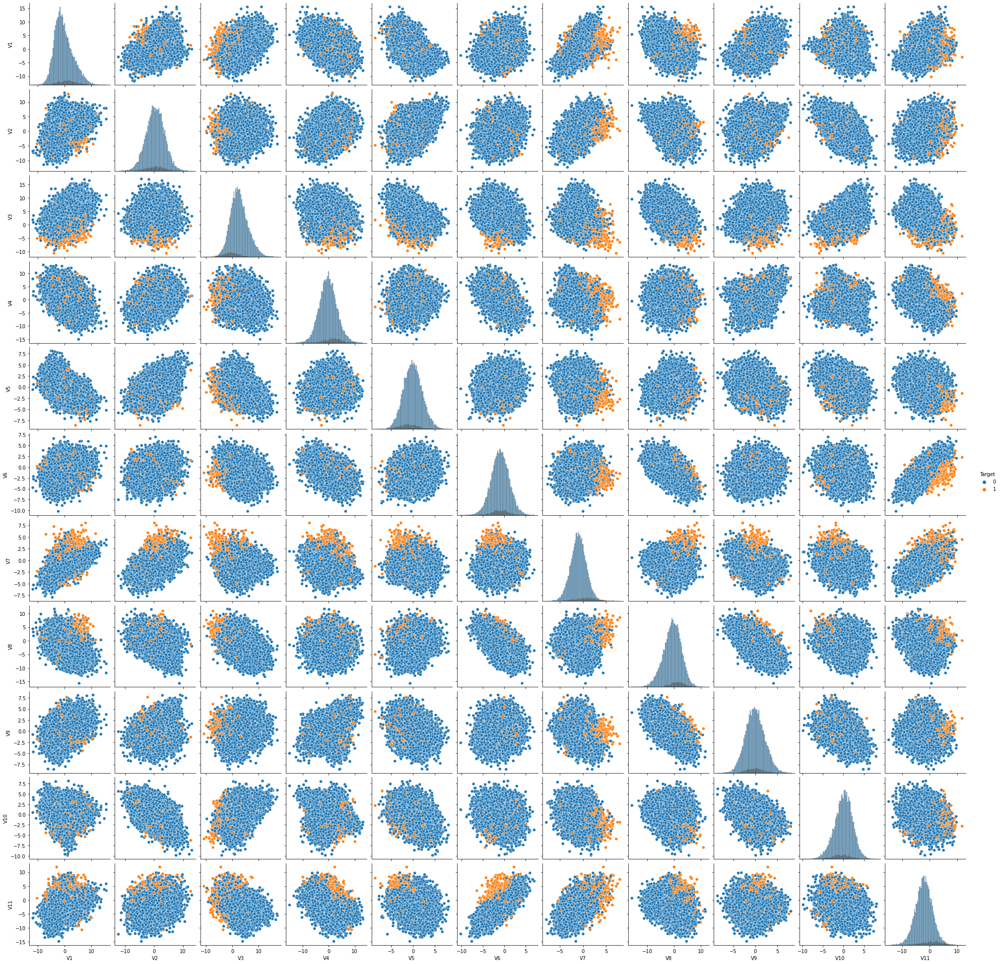

In [294]:
sns.pairplot(df_1, hue = 'Target' , diag_kind='hist')

* V1, V2 do not show any discriminatory pattern with failure
* With V3, failure tends to occur with low values of V3 (<0)
* V4, V5, V6 do not show any discriminatory pattern with failure
* With V7, failure tends to occur with high values of V7 (>2.5)
* With V8, failure tends to occur with high values of V7 (>0)
* V9, V10 do not show any discriminatory pattern with failure
* With V11, failure tends to occur with high values of V11 (>0)

In [295]:
df_2 = df.iloc[:,11:20]
df_2['Target'] = df['Target']

df_3 = df.iloc[:,20:30]
df_3['Target'] = df['Target']

df_4 = df.iloc[:,30:40]
df_4['Target'] = df['Target']

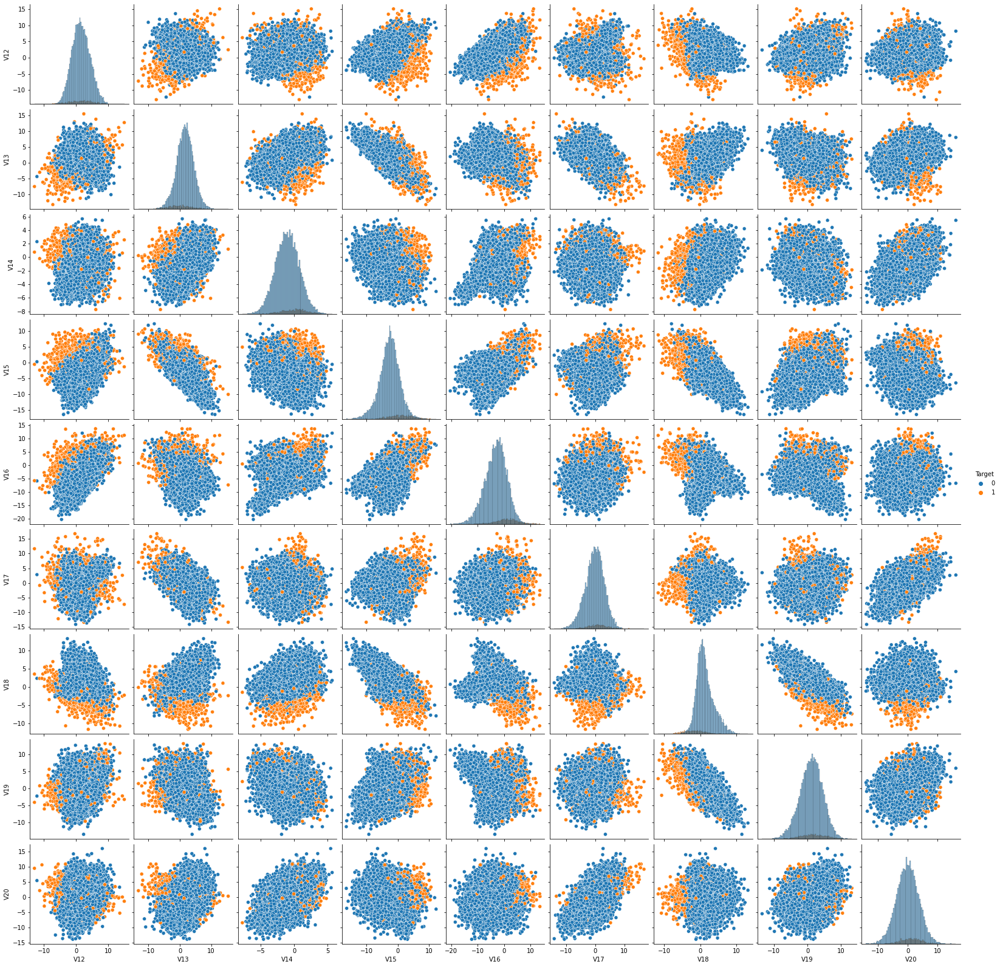

In [296]:
sns.pairplot(df_2, hue = 'Target' , diag_kind='hist')

* V12, V13,V14 do not show any discriminatory pattern with failure
* With V15, V16 failure tends to occur with high values of V15 (>0), V16(>0)
* V17 do not show any discriminatory pattern with failure
* With V18 failure tends to occur with mid and low values of V18 (<7.5)
* V19, V20 do not show any clear discriminatory pattern with failure

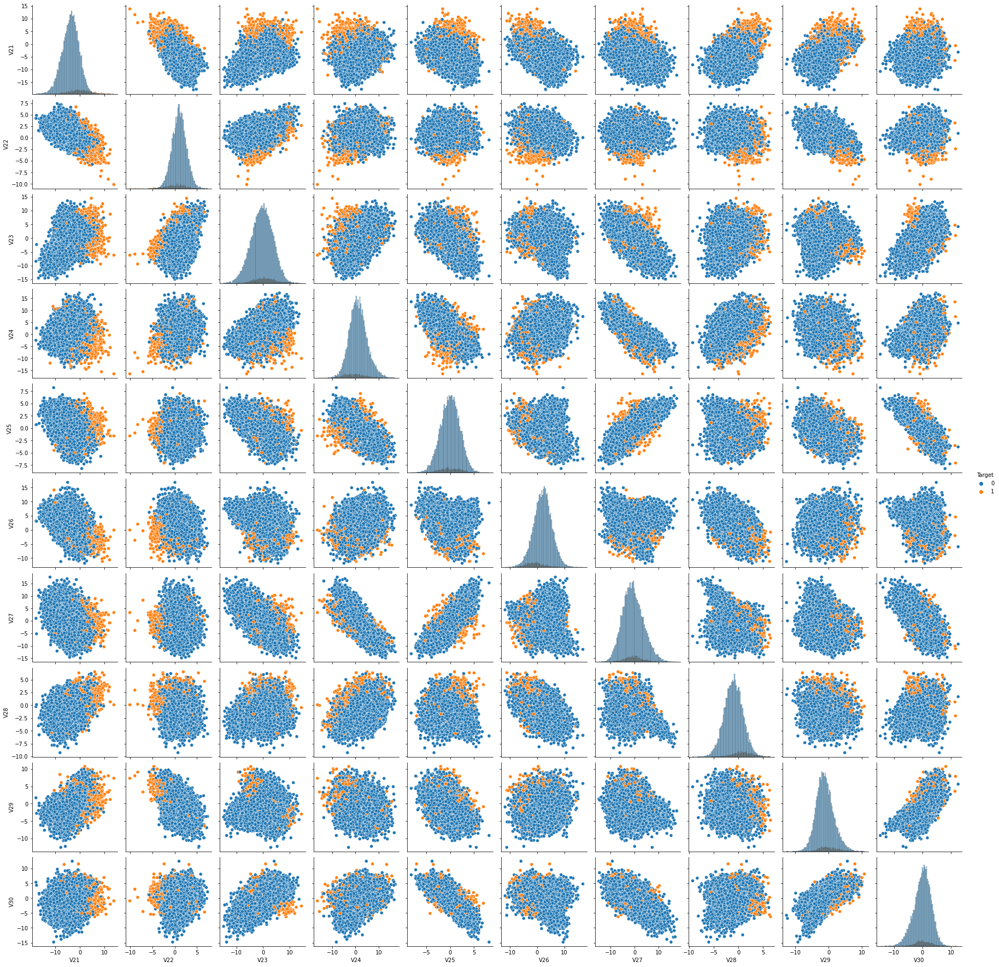

In [297]:
sns.pairplot(df_3, hue = 'Target' , diag_kind='hist')

* With V21, failure tends to occur with high values of V21 (>0)
* With V22, failure tends to occur with low values of V22 (<2.5)
* V24,V25,V27 do not show any clear discriminatory pattern with failure
* With V26, failure tends to occur with mid and low values of V26 (<5)
* With V28, failure tends to occur with high values of V28 (>0)
* V29, V30 do not show any discriminatory pattern with failure

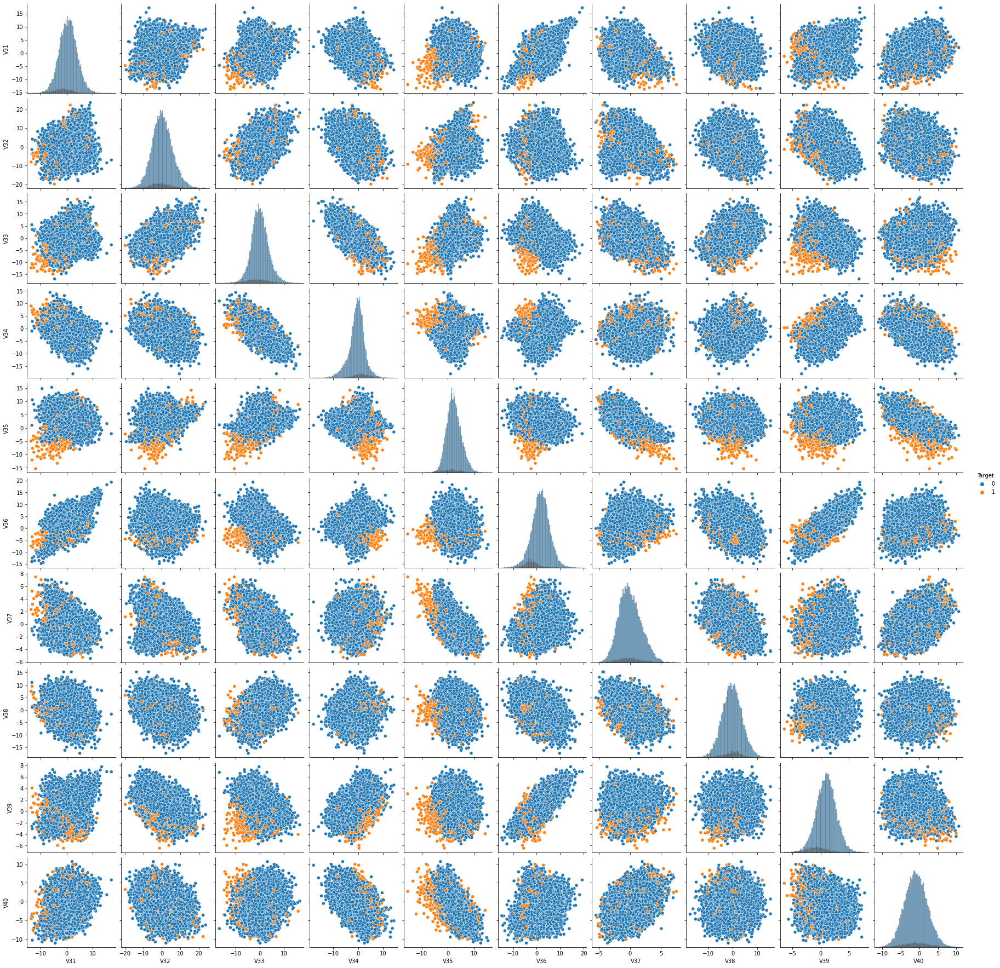

In [298]:
sns.pairplot(df_4, hue = 'Target' , diag_kind='hist')

* V31, V32 do not show any clear discriminatory pattern with failure
* V33, V35 shows a weak pattern of failure with low values of V33 (0), V35 (<0)
* V34 shows a weak pattern of failure with high values of V34 (>0)
* With V36, failure tends to occur within values ranging between -10 and 5
* V37, V38, V40 do not show any discriminatory pattern with failure
* V39 shows a weak pattern of failure with low values of V39 (<2)

In [299]:
### function to plot distributions wrt target


def distribution_plot_wrt_target(data, predictor):

    fig, axs = plt.subplots(2, 2, figsize=(12, 10))

    target = 'Target'

    target_uniq = data[target].unique()

    axs[0, 0].set_title("Distribution of target for target=" + str(target_uniq[0]))
    sns.histplot(
        data=data[data[target] == target_uniq[0]],
        x=predictor,
        kde=True,
        ax=axs[0, 0],
        color="teal",
        stat="density",
    )

    axs[0, 1].set_title("Distribution of target for target=" + str(target_uniq[1]))
    sns.histplot(
        data=data[data[target] == target_uniq[1]],
        x=predictor,
        kde=True,
        ax=axs[0, 1],
        color="orange",
        stat="density",
    )

    axs[1, 0].set_title("Boxplot w.r.t target")
    sns.boxplot(data=data, x=target, y=predictor, ax=axs[1, 0], palette="gist_rainbow")

    axs[1, 1].set_title("Boxplot (without outliers) w.r.t target")
    sns.boxplot(
        data=data,
        x=target,
        y=predictor,
        ax=axs[1, 1],
        showfliers=False,
        palette="gist_rainbow",
    )

    plt.tight_layout()
    plt.show()

In [300]:
df['Target']=df['Target'].astype('category')

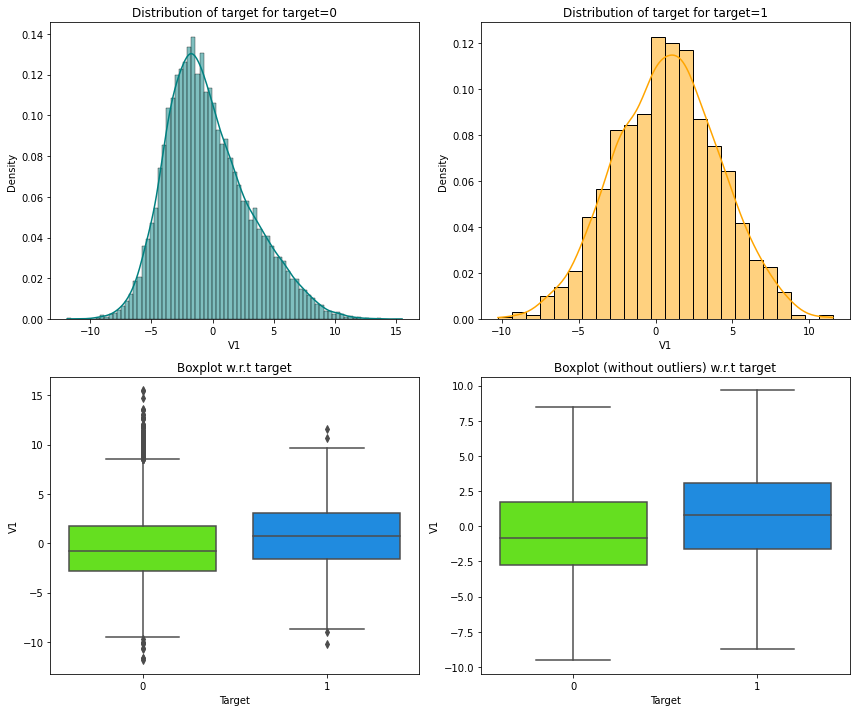

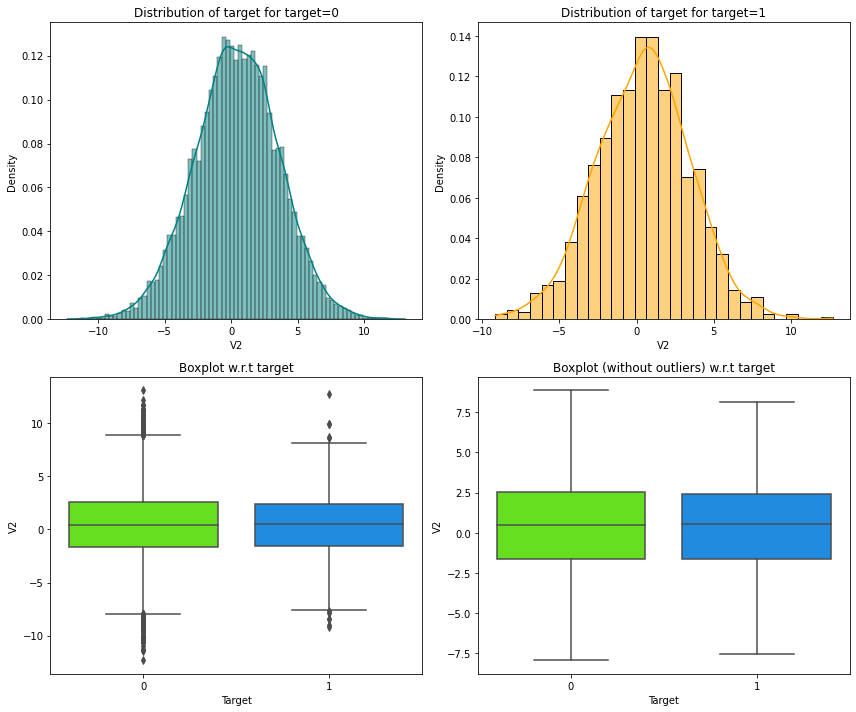

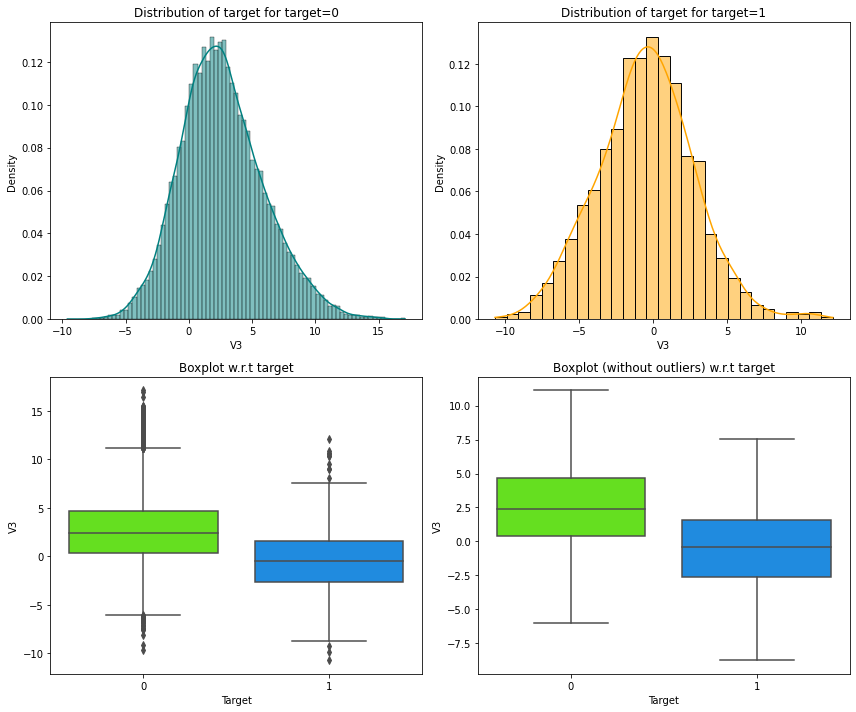

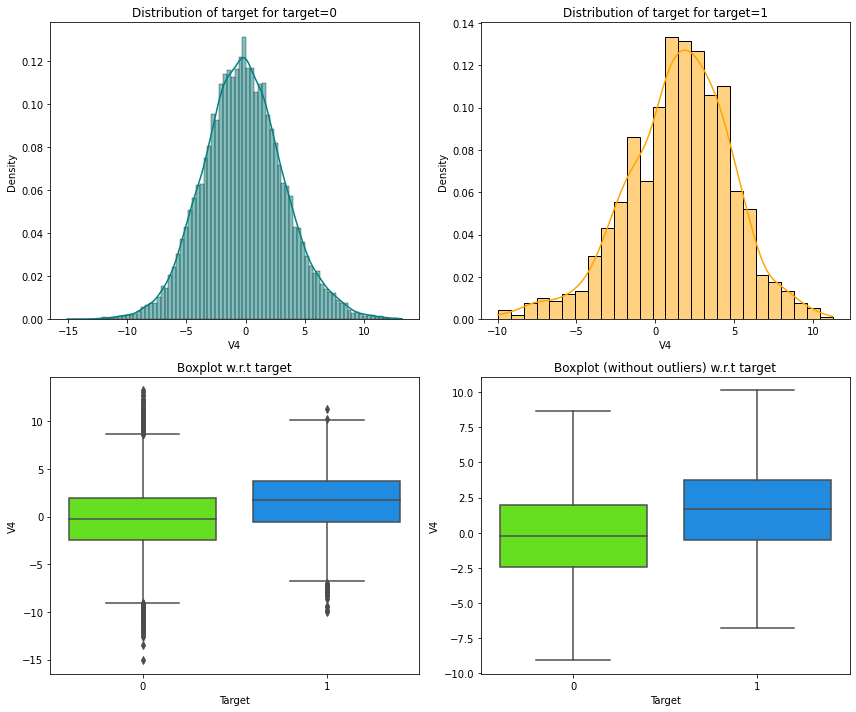

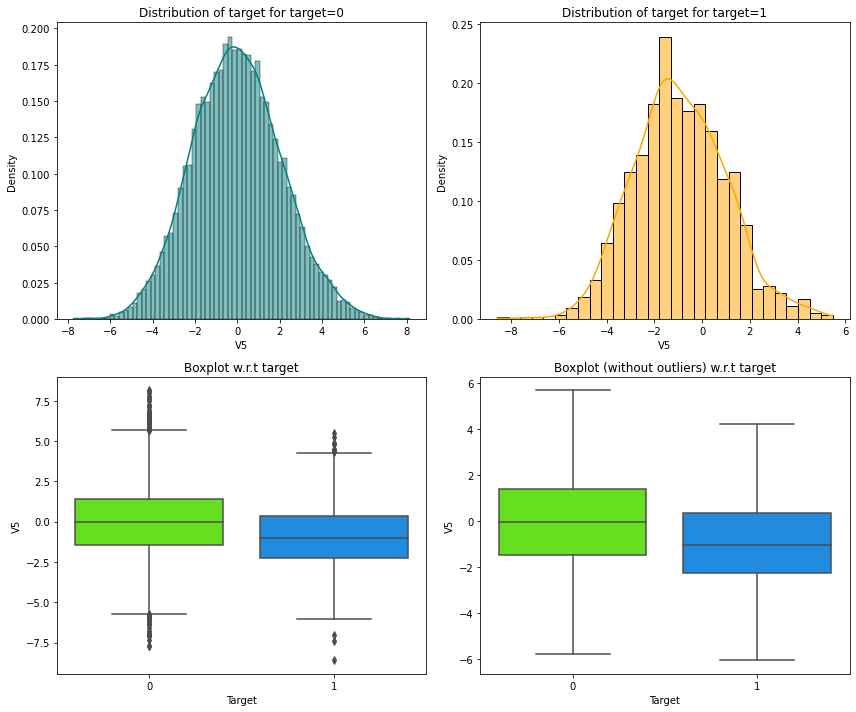

...

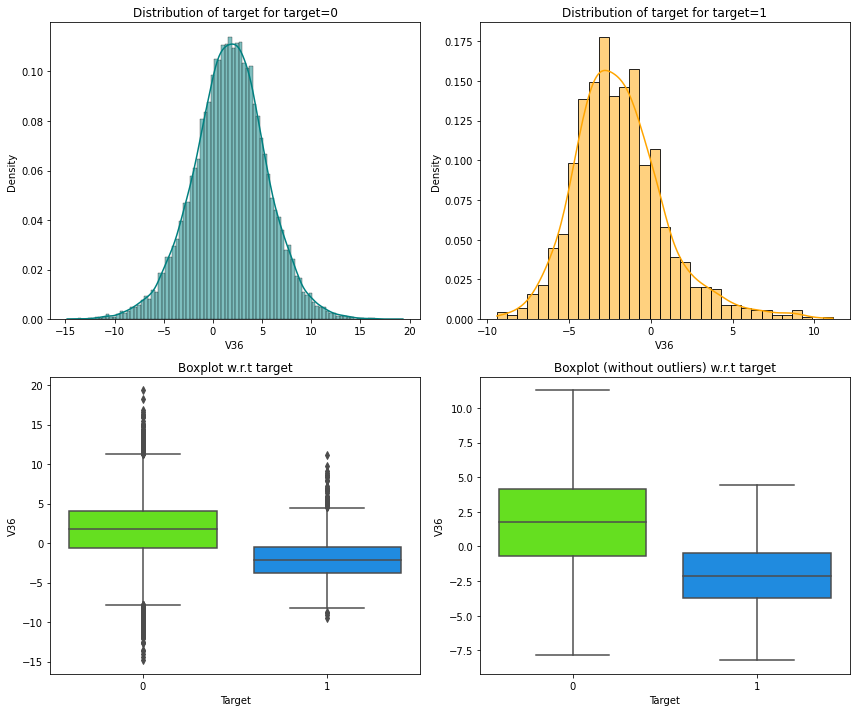

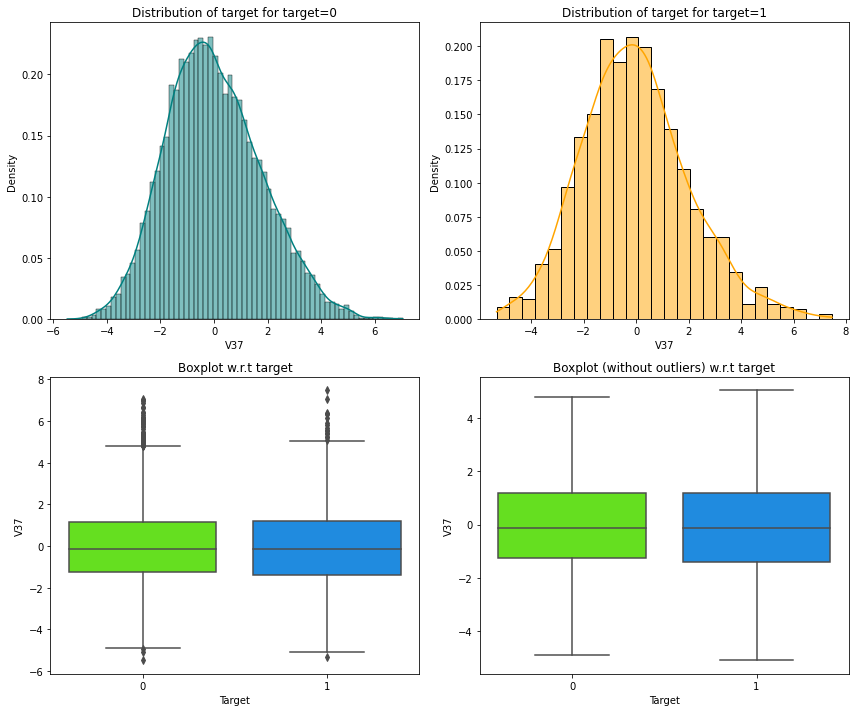

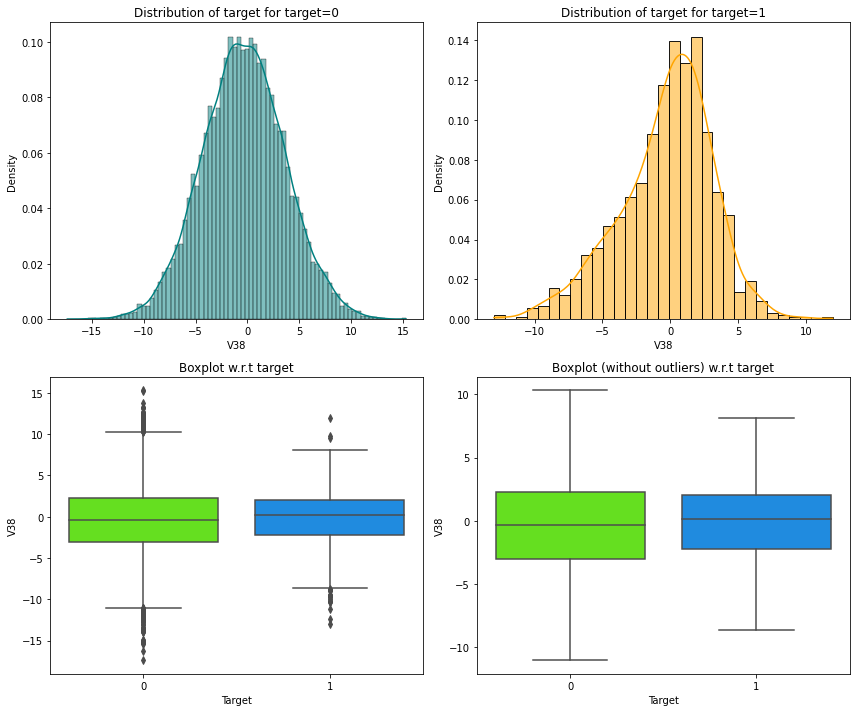

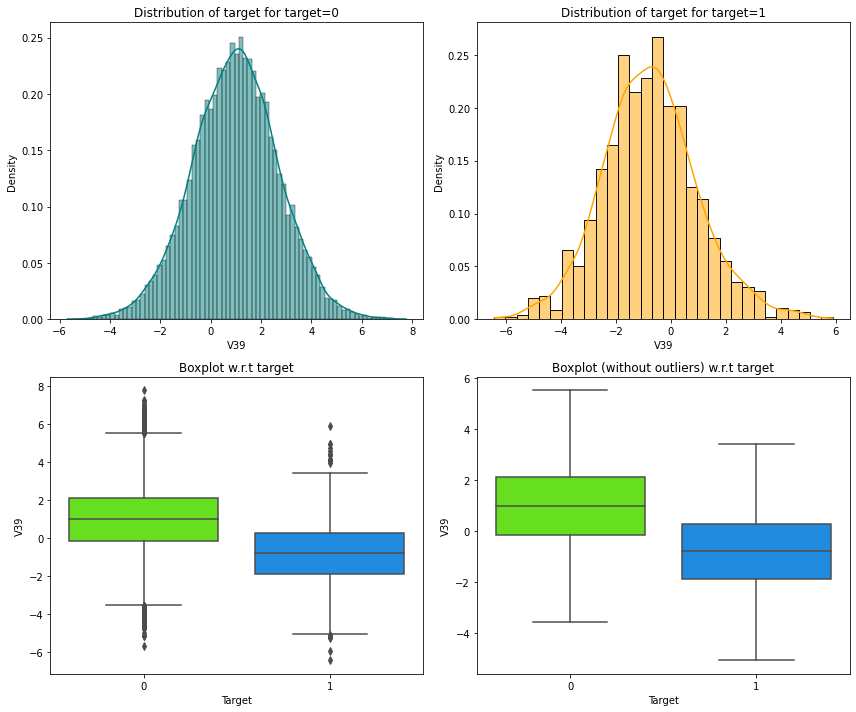

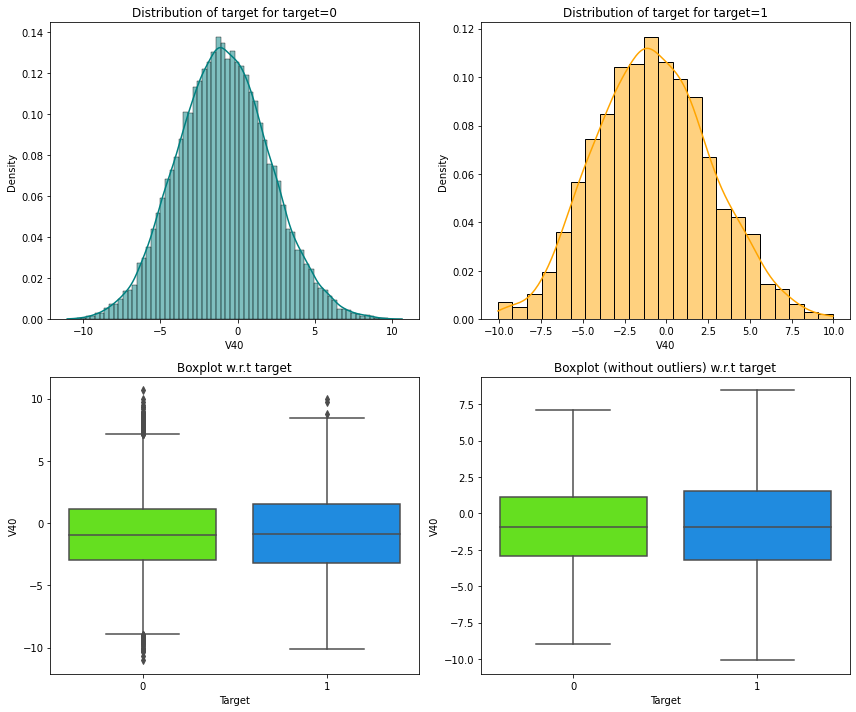

In [301]:
feature_columns = df.columns
feature_columns = feature_columns.drop('Target')
for predictor in feature_columns:
        distribution_plot_wrt_target(df, predictor)

* for most features, failure (Target value 1) is more likely to occur as the value of the feature increase.
* However, for V3, V5, V10, V13, V18, V22, V24, V25, V26, V31, V32, V35, V36 and V39 failure is more likely to occur as the value of the feature decrease 
* For V2, V6, V9, V12, V30 and V37 it appears there is no clear distinction between failure and non-failure

 

## Data Pre-processing

- Outlier check
- Preparing data for modeling 


### Outlier check

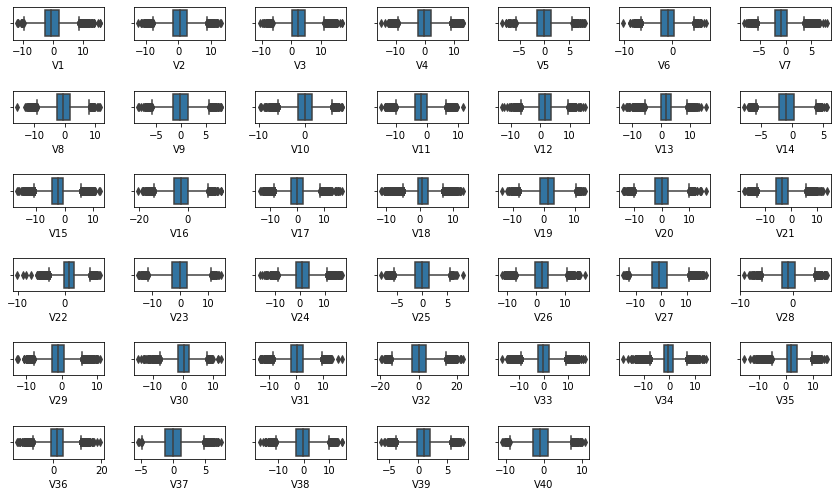

In [638]:
# outlier detection using boxplot
num_cols = df.select_dtypes(include=np.number).columns.tolist()

plt.figure(figsize=(12, 8))

for i, variable in enumerate(num_cols):
    plt.subplot(7, 7, i + 1)
    sns.boxplot(data=df, x=variable)
    plt.tight_layout(pad=2)

plt.show()

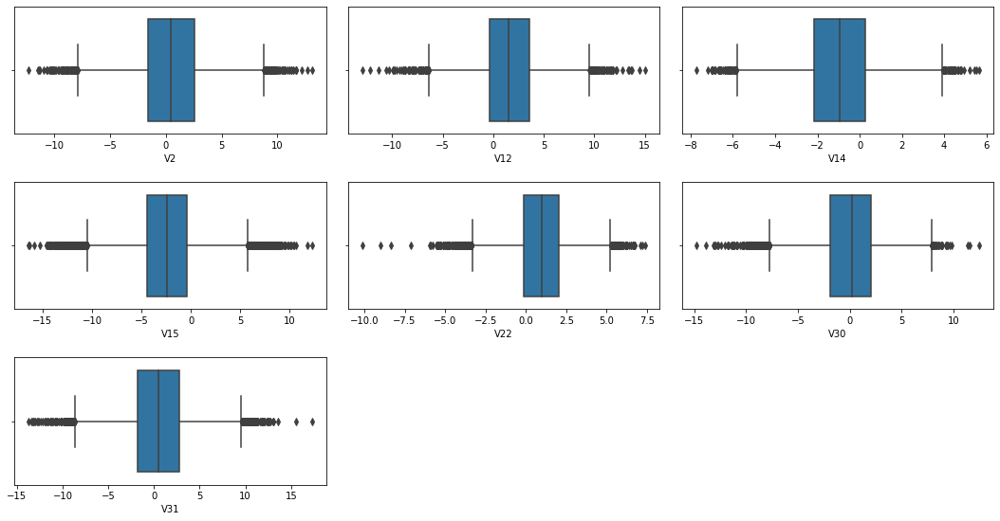

In [639]:
# selected features for outlier analysis
sel_cols = ['V2','V12','V14','V15','V22','V30','V31']

plt.figure(figsize=(15, 8))

for i, variable in enumerate(sel_cols):
    plt.subplot(3, 3, i + 1)
    sns.boxplot(data=df, x=variable)
    plt.tight_layout(pad=2)

plt.show()

* All the features values are normally distributed except the target variable
* Despite the selected features showing possible outliers it is difficult to interpret 
* The outliers will not be treated

### Splitting the data into X and y

In [643]:
# separating the independent and dependent variables
X = df.drop(["Target"], axis=1)
y = df["Target"]

# creating dummy variables
#X = pd.get_dummies(X, drop_first=True)

In [644]:
# Splitting data into training, validation and test set:

# Splitting data into 2 parts, temporary and test
X_temp, X_test, y_temp, y_test = train_test_split(
    X, y, test_size=0.2, random_state=1, stratify=y
)

# Splitting the temporary set into train and validation
X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=0.2, random_state=1, stratify=y_temp
)

print(X_train.shape, X_val.shape, X_test.shape)

(12800, 40) (3200, 40) (4000, 40)


## Missing value imputation




In [645]:
df.isnull().sum()

V1        18
V2        18
V3         0
V4         0
V5         0
V6         0
V7         0
V8         0
V9         0
V10        0
V11        0
V12        0
V13        0
V14        0
V15        0
V16        0
V17        0
V18        0
V19        0
V20        0
V21        0
V22        0
V23        0
V24        0
V25        0
V26        0
V27        0
V28        0
V29        0
V30        0
V31        0
V32        0
V33        0
V34        0
V35        0
V36        0
V37        0
V38        0
V39        0
V40        0
Target     0
dtype: int64

In [646]:
# Let's impute the missing values
imp_median = KNNImputer(n_neighbors=5)

# fit the imputer on train data and transform the train data
X_train["V1"] = imp_median.fit_transform(X_train[["V1"]])
X_train["V2"] = imp_median.fit_transform(X_train[["V2"]])

# transform the validation and test data using the imputer fit on train data
X_val["V1"] = imp_median.transform(X_val[["V1"]])
X_val["V2"] = imp_median.transform(X_val[["V2"]])

X_test["V1"] = imp_median.transform(X_test[["V1"]])
X_test["V2"] = imp_median.transform(X_test[["V2"]])

In [647]:
# Checking class balance for whole data, train set, validation set, and test set

print("Target value ratio in y")
print(y.value_counts(1))
print("*" * 80)
print("Target value ratio in y_train")
print(y_train.value_counts(1))
print("*" * 80)
print("Target value ratio in y_val")
print(y_val.value_counts(1))
print("*" * 80)
print("Target value ratio in y_test")
print(y_test.value_counts(1))
print("*" * 80)

Target value ratio in y
0   0.94
1   0.06
Name: Target, dtype: float64
********************************************************************************
Target value ratio in y_train
0   0.94
1   0.06
Name: Target, dtype: float64
********************************************************************************
Target value ratio in y_val
0   0.94
1   0.06
Name: Target, dtype: float64
********************************************************************************
Target value ratio in y_test
0   0.94
1   0.06
Name: Target, dtype: float64
********************************************************************************


# Decision Tree Model Building

### Model evaluation criterion

The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are failures correctly predicted by the model.
- False negatives (FN) are real failures in a generator where there is no detection by model. 
- False positives (FP) are failure detections in a generator where there is no failure.

**Which metric to optimize?**

* We need to choose the metric which will ensure that the maximum number of generator failures are predicted correctly by the model.
* We would want Recall to be maximized as greater the Recall, the higher the chances of minimizing false negatives.
* We want to minimize false negatives because if a model predicts that a machine will have no failure when there will be a failure, it will increase the maintenance cost.

**Let's define a function to output different metrics (including recall) on the train and test set and a function to show confusion matrix so that we do not have to use the same code repetitively while evaluating models.**

In [309]:
# defining a function to compute different metrics to check performance of a classification model built using sklearn
def model_performance_classification_sklearn(model, predictors, target):
    """
    Function to compute different metrics to check classification model performance

    model: classifier
    predictors: independent variables
    target: dependent variable
    """

    # predicting using the independent variables
    pred = model.predict(predictors)

    acc = accuracy_score(target, pred)  # to compute Accuracy
    recall = recall_score(target, pred)  # to compute Recall
    precision = precision_score(target, pred)  # to compute Precision
    f1 = f1_score(target, pred)  # to compute F1-score

    # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {
            "Accuracy": acc,
            "Recall": recall,
            "Precision": precision,
            "F1": f1
            
        },
        index=[0],
    )

    return df_perf

### Defining scorer to be used for cross-validation and hyperparameter tuning

- We want to reduce false negatives and will try to maximize "Recall".
- To maximize Recall, we can use Recall as a **scorer** in cross-validation and hyperparameter tuning.

In [310]:
# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

### Model Building with original data

Sample Decision Tree model building with original data 

In [311]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", DecisionTreeClassifier(random_state=1)))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on training dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train, y_train)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on training dataset:

dtree: 0.7183098591549295

Validation Performance:

dtree: 0.7359550561797753


In [312]:
# to check performance of the model on training data
dtree_default_model_train_perf = model_performance_classification_sklearn(
    model, X_train, y_train
)
dtree_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,1.00,1.00,1.00,1.00


In [313]:
# to check performance of the model on validat
dtree_default_model_val_perf = model_performance_classification_sklearn(
    model, X_val, y_val
)
dtree_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.74,0.75,0.74


* The default model is overfitting 

### Model Building with Oversampled data


In [648]:
# Synthetic Minority Over Sampling Technique
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
X_train_over, y_train_over = sm.fit_resample(X_train, y_train)

In [315]:
print("Before OverSampling, count of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, count of label '0': {} \n".format(sum(y_train == 0)))

print("After OverSampling, count of label '1': {}".format(sum(y_train_over == 1)))
print("After OverSampling, count of label '0': {} \n".format(sum(y_train_over == 0)))

print("After OverSampling, the shape of train_X: {}".format(X_train_over.shape))
print("After OverSampling, the shape of train_y: {} \n".format(y_train_over.shape))

Before OverSampling, count of label '1': 710
Before OverSampling, count of label '0': 12090 

After OverSampling, count of label '1': 12090
After OverSampling, count of label '0': 12090 

After OverSampling, the shape of train_X: (24180, 40)
After OverSampling, the shape of train_y: (24180,) 



#### Training decision tree classifier using the oversampled data

In [316]:
dtree1 = DecisionTreeClassifier(random_state=1, max_depth=4)

# training the decision tree model with oversampled training set
dtree1.fit(X_train_over, y_train_over)

DecisionTreeClassifier(max_depth=4, random_state=1)

#### Checking performance of oversampled train and validation data

In [317]:
# Predicting the target for train and validation set
pred_train = dtree1.predict(X_train_over)
pred_val = dtree1.predict(X_val)

In [318]:
# to check performance of the model
dtree_oversampled_model_train_perf = model_performance_classification_sklearn(
    dtree1, X_train, y_train
)
dtree_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.92,0.85,0.38,0.53


In [319]:
# to check performance of the model
dtree_oversampled_model_val_perf = model_performance_classification_sklearn(
    dtree1, X_val, y_val
)
dtree_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.92,0.80,0.41,0.54


Text(42.0, 0.5, 'Actual Values')

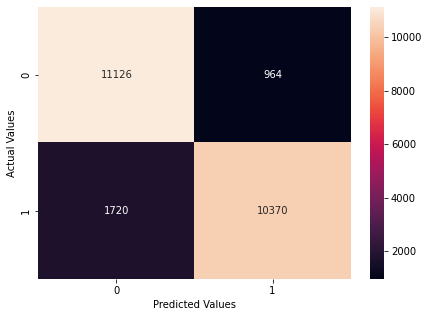

In [320]:
# Confusion matrix for oversampled train data
cm = confusion_matrix(y_train_over, pred_train)
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")


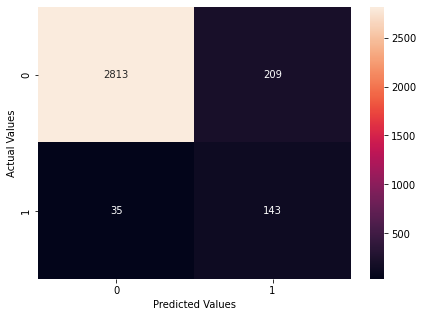

In [321]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, pred_val)
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* Recall for the oversampled data model decreased for the training data but increased for the validation data compared to the default model

### Model Building with Undersampled data

In [322]:
# Random undersampler for under sampling the data
rus = RandomUnderSampler(random_state=1, sampling_strategy=1)
X_train_un, y_train_un = rus.fit_resample(X_train, y_train)

In [323]:
print("Before Under Sampling, count of label '1': {}".format(sum(y_train == 1)))
print("Before Under Sampling, count of label '0': {} \n".format(sum(y_train == 0)))

print("After Under Sampling, count of label '1': {}".format(sum(y_train_un == 1)))
print("After Under Sampling, count of label '0': {} \n".format(sum(y_train_un == 0)))

print("After Under Sampling, the shape of train_X: {}".format(X_train_un.shape))
print("After Under Sampling, the shape of train_y: {} \n".format(y_train_un.shape))

Before Under Sampling, count of label '1': 710
Before Under Sampling, count of label '0': 12090 

After Under Sampling, count of label '1': 710
After Under Sampling, count of label '0': 710 

After Under Sampling, the shape of train_X: (1420, 40)
After Under Sampling, the shape of train_y: (1420,) 



#### Training decision tree classifier using the undersampled data

In [324]:
dtree2 = DecisionTreeClassifier(random_state=1, max_depth=4)

# training the decision tree model with oversampled training set
dtree2.fit(X_train_un, y_train_un)

DecisionTreeClassifier(max_depth=4, random_state=1)

#### Checking performance of undersampled train and validation data

In [325]:
# Predicting the target for train and validation set
pred_train = dtree2.predict(X_train_un)
pred_val = dtree2.predict(X_val)

In [326]:
# to check performance of the model
dtree_undersampled_model_train_perf = model_performance_classification_sklearn(
    dtree2, X_train, y_train
)
dtree_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.91,0.86,0.38,0.52


In [327]:
# to check performance of the model
dtree_undersampled_model_val_perf = model_performance_classification_sklearn(
    dtree2, X_val, y_val
)
dtree_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.92,0.85,0.39,0.53


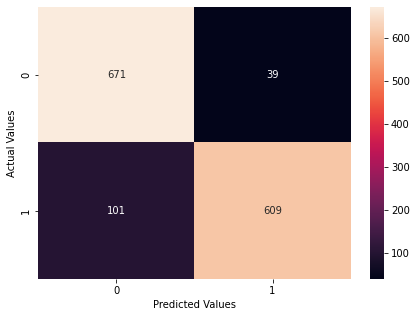

In [328]:
# Confusion matrix for undersampled train data
cm = confusion_matrix(y_train_un, pred_train)
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

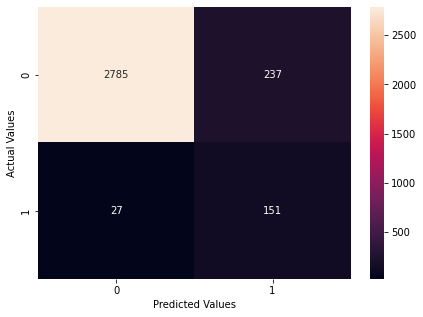

In [329]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, pred_val)
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* Recall for the undersampled data model decreased for the training data but increased for the validation data compared to the default model
* The undersampling model's performance on the validation data is higher than the oversampling model


## HyperparameterTuning 

### Sample Parameter Grids

**Hyperparameter tuning can take a long time to run, so to avoid that time complexity - you can use the following grids, wherever required.**

- For Gradient Boosting:

param_grid = {
    "n_estimators": np.arange(100,150,25),
    "learning_rate": [0.2, 0.05, 1],
    "subsample":[0.5,0.7], 
    "max_features":[0.5,0.7]
}

- For Adaboost:

param_grid = {
    "n_estimators": [100, 150, 200],
    "learning_rate": [0.2, 0.05],
    "base_estimator": [DecisionTreeClassifier(max_depth=1, random_state=1), DecisionTreeClassifier(max_depth=2, random_state=1), DecisionTreeClassifier(max_depth=3, random_state=1),
    ]
}

- For Bagging Classifier:

param_grid = {
    'max_samples': [0.8,0.9,1], 
    'max_features': [0.7,0.8,0.9],
    'n_estimators' : [30,50,70],
}

- For Random Forest:

param_grid = {
    "n_estimators": [200,250,300],
    "min_samples_leaf": np.arange(1, 4),
    "max_features": [np.arange(0.3, 0.6, 0.1),'sqrt'],
    "max_samples": np.arange(0.4, 0.7, 0.1)
}

- For Decision Trees:

param_grid = {
    'max_depth': np.arange(2,6), 
    'min_samples_leaf': [1, 4, 7],
    'max_leaf_nodes' : [10, 15],
    'min_impurity_decrease': [0.0001,0.001]
}

- For Logistic Regression:

param_grid = {'C': np.arange(0.1,1.1,0.1)}

- For XGBoost:

param_grid={
    'n_estimators': [150, 200, 250],
    'scale_pos_weight': [5,10],
    'learning_rate': [0.1,0.2],
    'gamma': [0,3,5],
    'subsample': [0.8,0.9]
}

### Tuning for Decision tree with original data

In [330]:
# defining model
Model = DecisionTreeClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_depth': np.arange(2,6),
              'min_samples_leaf': [1, 4, 7, 10], 
              'max_leaf_nodes' : [10,15,20],
              'min_impurity_decrease': [0.0001,0.001,0.01] }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'min_samples_leaf': 1, 'min_impurity_decrease': 0.001, 'max_leaf_nodes': 10, 'max_depth': 5} with CV score=0.4999999999999999:


In [331]:
# Set the clf to the best combination of parameters
dt1_tuned = DecisionTreeClassifier(    
    min_samples_leaf=1,
    max_leaf_nodes=10,
    max_depth=5,    
    min_impurity_decrease=0.001,
)

# Fit the best algorithm to the data.
dt1_tuned.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=5, max_leaf_nodes=10,
                       min_impurity_decrease=0.001)

In [332]:
# to check performance of the model
dtree_tuned_default_model_train_perf = model_performance_classification_sklearn(
    dt1_tuned, X_train, y_train
)
dtree_tuned_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.56,0.90,0.69


In [333]:
# to check performance of the model
dtree_tuned_default_model_val_perf = model_performance_classification_sklearn(
    dt1_tuned, X_val, y_val
)
dtree_tuned_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.57,0.85,0.68


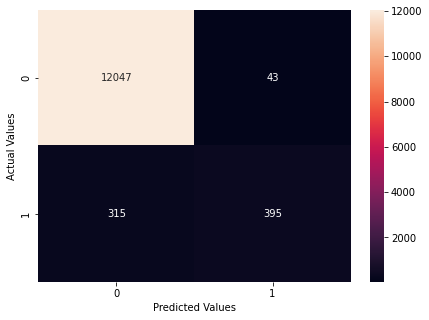

In [334]:
# Confusion matrix for undersampled train data
cm = confusion_matrix(y_train, dt1_tuned.predict(X_train))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

- Recall on both training set and validation set is got worse at  56% and 57%

### Tuning for Decision tree with oversampled data

In [335]:
# defining model
Model = DecisionTreeClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_depth': np.arange(2,6),
              'min_samples_leaf': [1, 4, 7,10], 
              'max_leaf_nodes' : [10,15,20],
              'min_impurity_decrease': [0.0001,0.001,0.01] }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'min_samples_leaf': 4, 'min_impurity_decrease': 0.001, 'max_leaf_nodes': 10, 'max_depth': 2} with CV score=0.9129859387923904:


In [336]:
# Set the clf to the best combination of parameters
dt2_tuned = DecisionTreeClassifier(    
    min_samples_leaf=1,
    max_leaf_nodes=15,
    max_depth=3,    
    min_impurity_decrease=0.0001,
)

# Fit the best algorithm to the data.
dt2_tuned.fit(X_train_over, y_train_over)

DecisionTreeClassifier(max_depth=3, max_leaf_nodes=15,
                       min_impurity_decrease=0.0001)

In [337]:
# to check performance of the model
dtree_tuned_oversampled_model_train_perf = model_performance_classification_sklearn(
    dt2_tuned, X_train, y_train
)
dtree_tuned_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.90,0.84,0.33,0.48


In [338]:
# to check performance of the model
dtree_tuned_oversampled_model_val_perf = model_performance_classification_sklearn(
    dt2_tuned, X_val, y_val
)
dtree_tuned_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.90,0.82,0.34,0.49


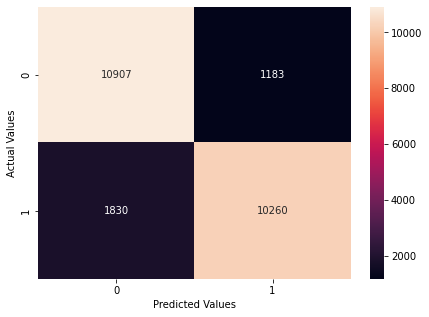

In [339]:
# Confusion matrix for oversampled train data
cm = confusion_matrix(y_train_over, dt2_tuned.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

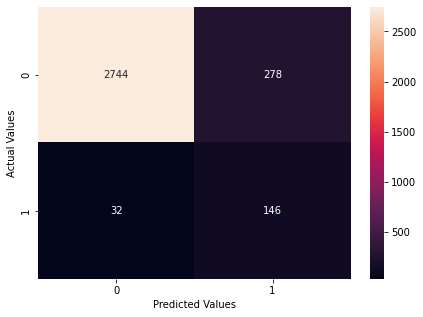

In [340]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, dt2_tuned.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* The tuned model of the oversampled data did not improved the recall of performance on training data (85.8% to 84.8%)
*The tuned model of the oversampled data improved the recall of performance on validation data (80.3% to 82.0%.) when compared to the untuned oversampling model


### Tuning for Decision tree with undersampled data

In [341]:
# defining model
Model = DecisionTreeClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_depth': np.arange(2,20),
              'min_samples_leaf': [1, 2, 5, 7], 
              'max_leaf_nodes' : [5, 10,15],
              'min_impurity_decrease': [0.0001,0.001] }

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=5, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'min_samples_leaf': 1, 'min_impurity_decrease': 0.001, 'max_leaf_nodes': 15, 'max_depth': 11} with CV score=0.8422535211267606:


In [342]:
# Set the clf to the best combination of parameters
dt3_tuned = DecisionTreeClassifier(    
    min_samples_leaf=1,
    max_leaf_nodes=15,
    max_depth=11,    
    min_impurity_decrease=0.001,
)

# Fit the best algorithm to the data.
dt3_tuned.fit(X_train_un, y_train_un)

DecisionTreeClassifier(max_depth=11, max_leaf_nodes=15,
                       min_impurity_decrease=0.001)

In [343]:
# to check performance of the model
dtree_tuned_undersampled_model_train_perf = model_performance_classification_sklearn(
    dt3_tuned, X_train, y_train
)
dtree_tuned_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.92,0.86,0.39,0.54


In [344]:
# to check performance of the model
dtree_tuned_undersampled_model_val_perf = model_performance_classification_sklearn(
    dt3_tuned, X_val, y_val
)
dtree_tuned_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.92,0.85,0.41,0.55


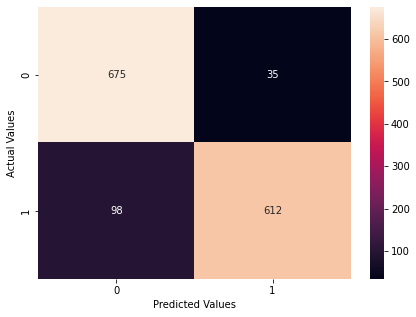

In [345]:
# Confusion matrix for undersampled train data
cm = confusion_matrix(y_train_un, dt3_tuned.predict(X_train_un))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

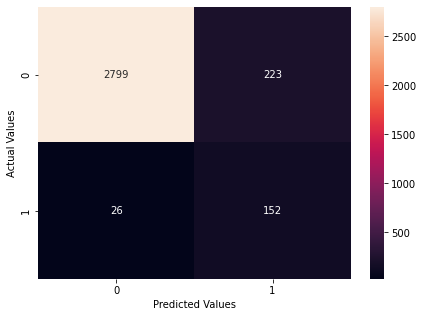

In [346]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, dt3_tuned.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* The performance of the tuned undersampling model is not different from the untuned undersampling model

## Decision Tree Models Comparison

In [347]:
# training performance comparison

models_train_comp_df = pd.concat(
    [
        dtree_default_model_train_perf.T,
        dtree_oversampled_model_train_perf.T,
        dtree_undersampled_model_train_perf.T,
        dtree_tuned_default_model_train_perf.T,
        dtree_tuned_oversampled_model_train_perf.T,
        dtree_tuned_undersampled_model_train_perf.T,
    ],
    axis=1,
)
models_train_comp_df.columns = [
    "Default Decision Tree",
    "Decision Tree with oversampled data",
    "Decision Tree with undersampled data",
    "Tuned Default Decision Tree",
    "Tuned Decision Tree with oversampled data",
    "Tuned Decision Tree with undersampled data",
]
print("Training performance comparison:")
models_train_comp_df

Training performance comparison:


,Default Decision Tree,Decision Tree with oversampled data,Decision Tree with undersampled data,Tuned Default Decision Tree,Tuned Decision Tree with oversampled data,Tuned Decision Tree with undersampled data
Accuracy,1.00,0.92,0.91,0.97,0.90,0.92
Recall,1.00,0.85,0.86,0.56,0.84,0.86
Precision,1.00,0.38,0.38,0.90,0.33,0.39
F1,1.00,0.53,0.52,0.69,0.48,0.54


In [348]:
# Validation performance comparison

models_val_comp_df = pd.concat(
    [
        dtree_default_model_val_perf.T,
        dtree_oversampled_model_val_perf.T,
        dtree_undersampled_model_val_perf.T,
        dtree_tuned_default_model_val_perf.T,
        dtree_tuned_oversampled_model_val_perf.T,
        dtree_tuned_undersampled_model_val_perf.T,
    ],
    axis=1,
)
models_val_comp_df.columns = [
    "Default Decision Tree",
    "Decision Tree with oversampled data",
    "Decision Tree with undersampled data",
    "Tuned Default Decision Tree",
    "Tuned Decision Tree with oversampled data",
    "Tuned Decision Tree with undersampled data",
]
print("Validation performance comparison:")
models_val_comp_df

Validation performance comparison:


,Default Decision Tree,Decision Tree with oversampled data,Decision Tree with undersampled data,Tuned Default Decision Tree,Tuned Decision Tree with oversampled data,Tuned Decision Tree with undersampled data
Accuracy,0.97,0.92,0.92,0.97,0.90,0.92
Recall,0.74,0.80,0.85,0.57,0.82,0.85
Precision,0.75,0.41,0.39,0.85,0.34,0.41
F1,0.74,0.54,0.53,0.68,0.49,0.55


* From the comparison tables the best models are the `Decision Tree with Undersampled Data` and `Tuned Decision Tree with Undersampled Data`. 
* `Decision Tree with Undersampled Data` will be selected for the Decision Tree models because it is simpler

In [349]:
# to check performance of the model on the test data
dtree_undersampled_model_test_perf = model_performance_classification_sklearn(
    dtree2, X_test, y_test
)
dtree_undersampled_model_test_perf

,Accuracy,Recall,Precision,F1
0,0.91,0.84,0.35,0.50


* The `Decision Tree with Undersampled Data` model has recall performance on the test data of 84% which is comparable to the model's recall performance on the validation data (85%)

Text(42.0, 0.5, 'Actual Values')

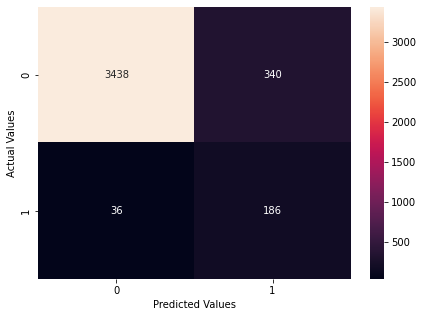

In [350]:
# Confusion matrix for the selected model on test data
cm = confusion_matrix(y_test, dtree2.predict(X_test))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

In [351]:
# importance of features in the tree building

print(pd.DataFrame(dtree2.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

     Imp
V18 0.45
V39 0.21
V3  0.13
V26 0.09
V10 0.03
V9  0.03
V11 0.02
V13 0.02
V12 0.02
V14 0.01
V38 0.00
V35 0.00
V36 0.00
V37 0.00
V25 0.00
V34 0.00
V33 0.00
V32 0.00
V31 0.00
V30 0.00
V29 0.00
V28 0.00
V27 0.00
V1  0.00
V21 0.00
V24 0.00
V23 0.00
V22 0.00
V2  0.00
V20 0.00
V19 0.00
V17 0.00
V16 0.00
V15 0.00
V8  0.00
V7  0.00
V6  0.00
V5  0.00
V4  0.00
V40 0.00


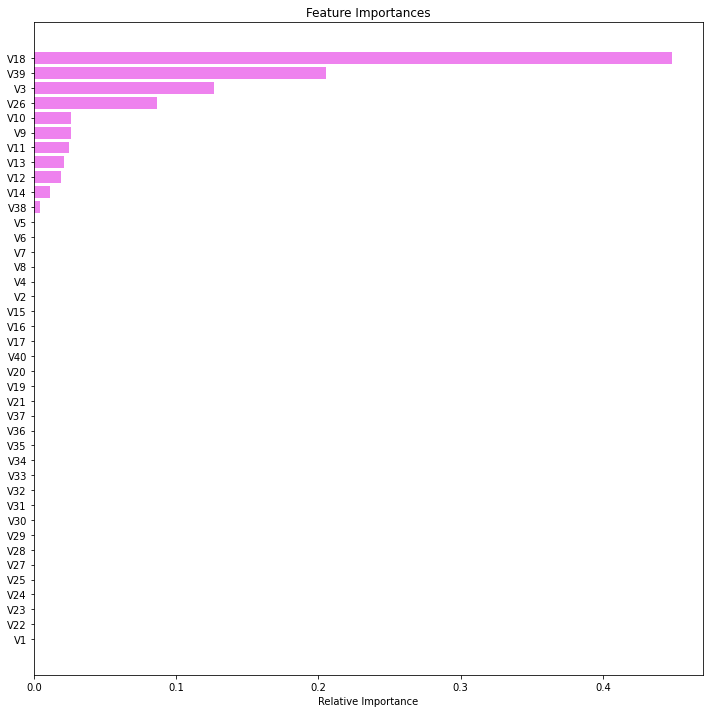

In [352]:
feature_names = X_train.columns
importances = dtree2.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

* The most important and most likely feature to cause failure based on the selected decision tree model is V18 with a probability of 45%
* Others significant features are V39, V3, V26 with failure probability of 21%, 13% and 9% respectively

# Random Forest Model Building

### Model Building with original data

In [353]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", RandomForestClassifier(random_state=1)))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on training dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train, y_train)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on training dataset:

dtree: 0.7084507042253521

Validation Performance:

dtree: 0.7078651685393258


In [354]:
# to check performance of the model on training data
rf_default_model_train_perf = model_performance_classification_sklearn(
    model, X_train, y_train
)
rf_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,1.00,1.00,1.00,1.00


In [355]:
# to check performance of the model on validation data
rf_default_model_val_perf = model_performance_classification_sklearn(
    model, X_val, y_val
)
rf_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.71,0.98,0.82


* The default model is overfitting 

### Model Building with Oversampled data


In [356]:
rf1 = RandomForestClassifier(random_state=1)

# training the random forest model with oversampled training set
rf1.fit(X_train_over, y_train_over)

RandomForestClassifier(random_state=1)

#### Checking performance of oversampled train and validation data

In [357]:
# to check performance of the model
rf_oversampled_model_train_perf = model_performance_classification_sklearn(
    rf1, X_train, y_train
)
rf_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,1.00,1.00,1.00,1.00


In [358]:
# to check performance of the model
rf_oversampled_model_val_perf = model_performance_classification_sklearn(
    rf1, X_val, y_val
)
rf_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.85,0.96,0.90


Text(42.0, 0.5, 'Actual Values')

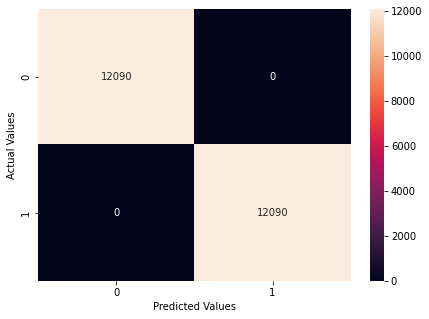

In [359]:
# Confusion matrix for oversampled train data
cm = confusion_matrix(y_train_over, rf1.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")


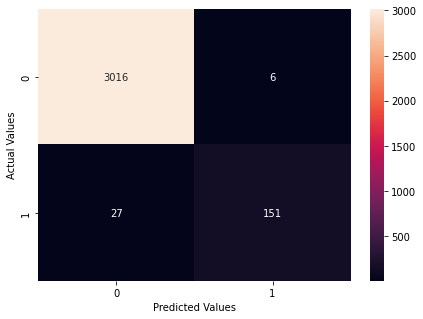

In [360]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, rf1.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* The oversampling model is also overfitting though it has a better recall performance on the valdation data

### Model Building with Undersampled data


In [361]:
rf2 = RandomForestClassifier(random_state=1)

# training the random forest model with unersampled training set
rf2.fit(X_train_un, y_train_un)

RandomForestClassifier(random_state=1)

#### Checking performance of undersampled train and validation data

In [362]:
# to check performance of the model
rf_undersampled_model_train_perf = model_performance_classification_sklearn(
    rf2, X_train, y_train
)
rf_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.96,1.00,0.60,0.75


In [363]:
# to check performance of the model
rf_undersampled_model_val_perf = model_performance_classification_sklearn(
    rf2, X_val, y_val
)
rf_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.92,0.63,0.75


Text(42.0, 0.5, 'Actual Values')

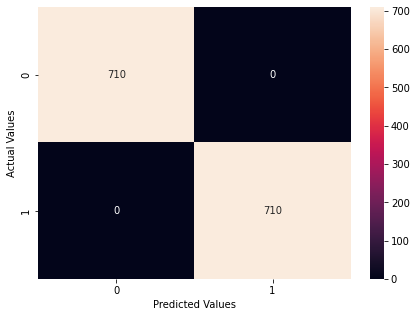

In [364]:
# Confusion matrix for undersampled train data
cm = confusion_matrix(y_train_un, rf2.predict(X_train_un))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

Text(42.0, 0.5, 'Actual Values')

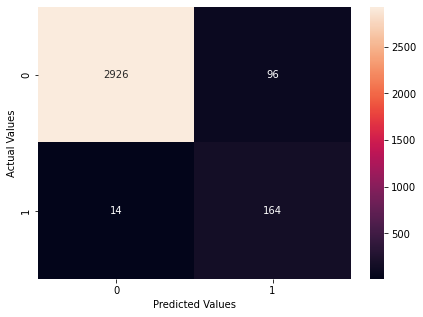

In [365]:
# Confusion matrix for undersampled validation data
cm = confusion_matrix(y_val, rf2.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

* The undersampling model is also overfitting though it has a better recall performance on the valdation data that the both the default model and the oversampling model

### Tuning for Random Forest with original data

param_grid = { "n_estimators": [200,250,300], "min_samples_leaf": np.arange(1, 4), "max_features": [np.arange(0.3, 0.6, 0.1),'sqrt'], "max_samples": np.arange(0.4, 0.7, 0.1) }

In [366]:
# defining model
Model = RandomForestClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [200,250,300],
              'min_samples_leaf': [1, 4], 
              'max_features' : [np.arange(0.3, 0.6, 0.1),'sqrt'],
              'max_samples': np.arange(0.4, 0.7, 0.1) }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 200, 'min_samples_leaf': 1, 'max_samples': 0.6, 'max_features': 'sqrt'} with CV score=0.6901408450704226:


In [367]:
# Set the clf to the best combination of parameters
rf1_tuned = RandomForestClassifier(    
    n_estimators=200,
    min_samples_leaf=1,
    max_features='sqrt',    
    max_samples=0.6,
)

# Fit the best algorithm to the data.
rf1_tuned.fit(X_train, y_train)

RandomForestClassifier(max_features='sqrt', max_samples=0.6, n_estimators=200)

In [368]:
# to check performance of the model on the training data
rf1_tuned_default_model_train_perf = model_performance_classification_sklearn(
    rf1_tuned, X_train, y_train
)
rf1_tuned_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.90,1.00,0.95


In [369]:
# to check performance of the model on the validation data
rf1_tuned_default_model_val_perf = model_performance_classification_sklearn(
    rf1_tuned, X_val, y_val
)
rf1_tuned_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.70,0.98,0.82


* The tuned default model is still overfitting and the recall performance has not improved compared to the untuned default model

### Tuning for Random Forest with oversampled data

In [370]:
# defining model
Model = RandomForestClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [200,250,300],
              'min_samples_leaf': [1, 4], 
              'max_features' : [np.arange(0.3, 0.6, 0.1),'sqrt'],
              'max_samples': np.arange(0.4, 0.7, 0.1) }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 200, 'min_samples_leaf': 1, 'max_samples': 0.6, 'max_features': 'sqrt'} with CV score=0.9812241521918942:


In [371]:
# Set the clf to the best combination of parameters
rf2_tuned = RandomForestClassifier(    
    n_estimators=200,
    min_samples_leaf=1,
    max_features='sqrt',    
    max_samples=0.6,
)

# Fit the best algorithm to the data.
rf2_tuned.fit(X_train_over, y_train_over)

RandomForestClassifier(max_features='sqrt', max_samples=0.6, n_estimators=200)

In [372]:
# to check performance of the model on the training data
rf2_tuned_oversampled_model_train_perf = model_performance_classification_sklearn(
    rf2_tuned, X_train, y_train
)
rf2_tuned_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,1.00,1.00,1.00,1.00


In [373]:
# to check performance of the model on the validation data
rf2_tuned_oversampled_model_val_perf = model_performance_classification_sklearn(
    rf2_tuned, X_val, y_val
)
rf2_tuned_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.87,0.96,0.91


* The tuned oversampled model is also overfitting and the recall performance has improved slightly compared to the untuned oversampled model

### Tuning for Random Forest with undersampled data

In [374]:
# defining model
Model = RandomForestClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [200,250,300],
              'min_samples_leaf': [1, 4], 
              'max_features' : [np.arange(0.3, 0.6, 0.1),'sqrt'],
              'max_samples': np.arange(0.4, 0.7, 0.1) }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 200, 'min_samples_leaf': 1, 'max_samples': 0.6, 'max_features': 'sqrt'} with CV score=0.8774647887323944:


In [375]:
# Set the clf to the best combination of parameters
rf3_tuned = RandomForestClassifier(    
    n_estimators=200,
    min_samples_leaf=1,
    max_features='sqrt',    
    max_samples=0.6,
)

# Fit the best algorithm to the data.
rf3_tuned.fit(X_train_un, y_train_un)

RandomForestClassifier(max_features='sqrt', max_samples=0.6, n_estimators=200)

In [376]:
# to check performance of the model on the training data
rf3_tuned_undersampled_model_train_perf = model_performance_classification_sklearn(
    rf3_tuned, X_train, y_train
)
rf3_tuned_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.96,0.98,0.58,0.73


In [377]:
# to check performance of the model on the validation data
rf3_tuned_undersampled_model_val_perf = model_performance_classification_sklearn(
    rf3_tuned, X_val, y_val
)
rf3_tuned_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.96,0.92,0.59,0.71


* The tuned undersampled model is generalizing better though the recall performance is similar to the untuned undersampled model

## Random Forest Models Comparison

In [378]:
# training performance comparison

models_train_comp_df = pd.concat(
    [
        rf_default_model_train_perf.T,
        rf_oversampled_model_train_perf.T,
        rf_undersampled_model_train_perf.T,
        rf1_tuned_default_model_train_perf.T,
        rf2_tuned_oversampled_model_train_perf.T,
        rf3_tuned_undersampled_model_train_perf.T,
    ],
    axis=1,
)
models_train_comp_df.columns = [
    "Default Random Forest",
    "Random Forest with oversampled data",
    "Random Forest with undersampled data",
    "Tuned Default Random Forest",
    "Tuned Random Forest with oversampled data",
    "Tuned Random Forest with undersampled data",
]
print("Training performance comparison:")
models_train_comp_df

Training performance comparison:


,Default Random Forest,Random Forest with oversampled data,Random Forest with undersampled data,Tuned Default Random Forest,Tuned Random Forest with oversampled data,Tuned Random Forest with undersampled data
Accuracy,1.00,1.00,0.96,0.99,1.00,0.96
Recall,1.00,1.00,1.00,0.90,1.00,0.98
Precision,1.00,1.00,0.60,1.00,1.00,0.58
F1,1.00,1.00,0.75,0.95,1.00,0.73


In [379]:
# Validation performance comparison

models_val_comp_df = pd.concat(
    [
        rf_default_model_val_perf.T,
        rf_oversampled_model_val_perf.T,
        rf_undersampled_model_val_perf.T,
        rf1_tuned_default_model_val_perf.T,
        rf2_tuned_oversampled_model_val_perf.T,
        rf3_tuned_undersampled_model_val_perf.T,
    ],
    axis=1,
)
models_val_comp_df.columns = [
    "Default Random Forest",
    "Random Forest with oversampled data",
    "Random Forest with undersampled data",
    "Tuned Default Random Forest",
    "Tuned Random Forest with oversampled data",
    "Tuned Random Forest with undersampled data",
]
print("Validation performance comparison:")
models_val_comp_df

Validation performance comparison:


,Default Random Forest,Random Forest with oversampled data,Random Forest with undersampled data,Tuned Default Random Forest,Tuned Random Forest with oversampled data,Tuned Random Forest with undersampled data
Accuracy,0.98,0.99,0.97,0.98,0.99,0.96
Recall,0.71,0.85,0.92,0.70,0.87,0.92
Precision,0.98,0.96,0.63,0.98,0.96,0.59
F1,0.82,0.90,0.75,0.82,0.91,0.71


* All the models are overfitting 
* From the comparison tables the best models are the `Random Forest with Undersampled Data` and `Tuned Random Forest with Undersampled Data`. 
* `Tuned Random Forest with Undersampled Data` will be selected for the Decision Tree models because it generalizes better

In [380]:
# to check performance of the model on the test data
rf3_tuned_undersampled_model_test_perf = model_performance_classification_sklearn(
    rf3_tuned, X_test, y_test
)
rf3_tuned_undersampled_model_test_perf

,Accuracy,Recall,Precision,F1
0,0.95,0.87,0.52,0.65


* The recall performance on the `X_test` data shows that the models is overfitting and may be unreliable

Text(42.0, 0.5, 'Actual Values')

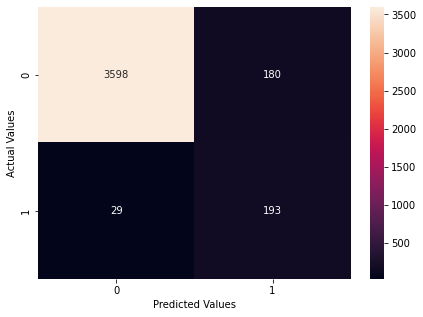

In [381]:
# Confusion matrix for the selected model on test data
cm = confusion_matrix(y_test, rf3_tuned.predict(X_test))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

In [382]:
# importance of features in the tree building

print(pd.DataFrame(rf3_tuned.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

     Imp
V36 0.09
V18 0.09
V39 0.06
V15 0.04
V26 0.04
V16 0.04
V21 0.03
V7  0.03
V14 0.03
V28 0.03
V11 0.03
V3  0.03
V12 0.03
V9  0.03
V34 0.02
V13 0.02
V35 0.02
V5  0.02
V4  0.02
V37 0.02
V20 0.02
V31 0.02
V38 0.02
V24 0.02
V2  0.02
V40 0.02
V30 0.01
V33 0.01
V19 0.01
V10 0.01
V6  0.01
V25 0.01
V8  0.01
V1  0.01
V27 0.01
V17 0.01
V22 0.01
V23 0.01
V29 0.01
V32 0.01


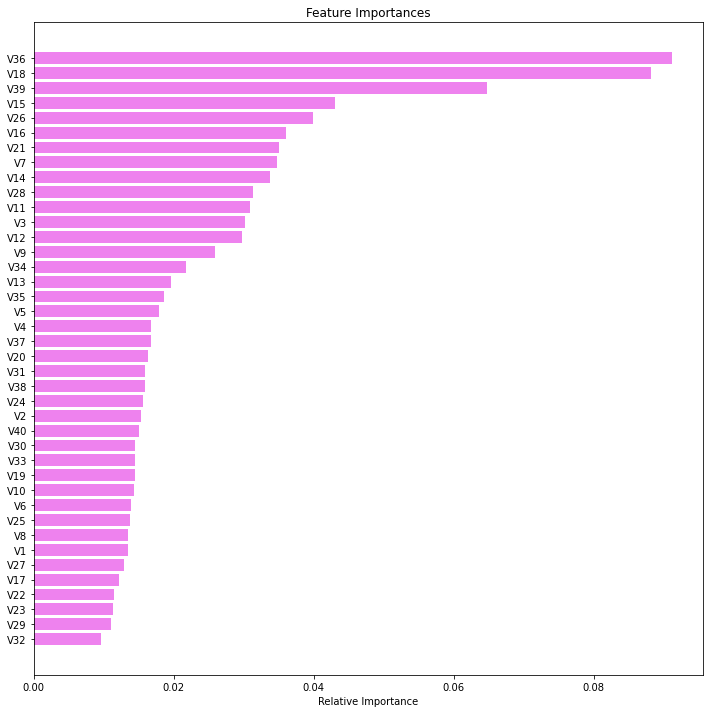

In [383]:
feature_names = X_train.columns
importances = rf3_tuned.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

* The most likely feature to cause failure based on the selected random forest model is V18 with a probability of 10%
* Others significant features are V36, V39 with failure probability of 8% and 6% respectively

# Logistic Regression Model Building

### Model Building with original data

In [384]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", LogisticRegression(random_state=1)))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on training dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train, y_train)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on training dataset:

dtree: 0.476056338028169

Validation Performance:

dtree: 0.5


In [385]:
# to check performance of the model on training data
lgr_default_model_train_perf = model_performance_classification_sklearn(
    model, X_train, y_train
)
lgr_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.48,0.86,0.62


In [386]:
# to check performance of the model on validation data
lgr_default_model_val_perf = model_performance_classification_sklearn(
    model, X_val, y_val
)
lgr_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.50,0.83,0.62


* Though the default model is not overfitting the recall performance is poor

### Model Building with Oversampled data


In [387]:
lgr1 = LogisticRegression(random_state=1)

# training the logistic regression model with oversampled training set
lgr1.fit(X_train_over, y_train_over)

LogisticRegression(random_state=1)

#### Checking performance of oversampled train and validation data

In [388]:
# to check performance of the model training data
lgr_oversampled_model_train_perf = model_performance_classification_sklearn(
    lgr1, X_train, y_train
)
lgr_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.87,0.85,0.28,0.42


In [389]:
# to check performance of the model on the validation data
lgr_oversampled_model_val_perf = model_performance_classification_sklearn(
    lgr1, X_val, y_val
)
lgr_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.87,0.89,0.29,0.44


Text(42.0, 0.5, 'Actual Values')

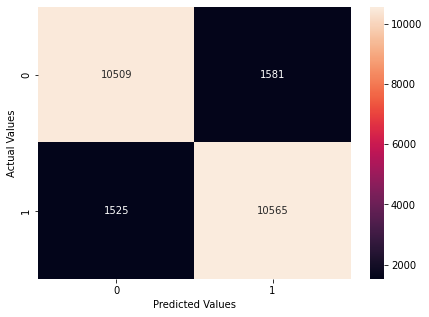

In [390]:
# Confusion matrix for oversampled train data
cm = confusion_matrix(y_train_over, lgr1.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

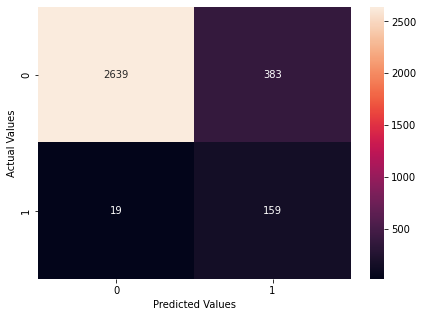

In [391]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, lgr1.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* The oversampled model is not overfitting and the recall performance is much higher than the default model

### Model Building with Undersampled data


In [392]:
lgr2 = LogisticRegression(random_state=1)

# training the logistic regression model with undersampled training set
lgr2.fit(X_train_un, y_train_un)

LogisticRegression(random_state=1)

#### Checking performance of undersampled train and validation data

In [393]:
# to check performance of the model on the training data
lgr_undersampled_model_train_perf = model_performance_classification_sklearn(
    lgr2, X_train, y_train
)
lgr_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.87,0.85,0.27,0.41


In [394]:
# to check performance of the model on the validation data
lgr_undersampled_model_val_perf = model_performance_classification_sklearn(
    lgr2, X_val, y_val
)
lgr_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.87,0.89,0.29,0.44


Text(42.0, 0.5, 'Actual Values')

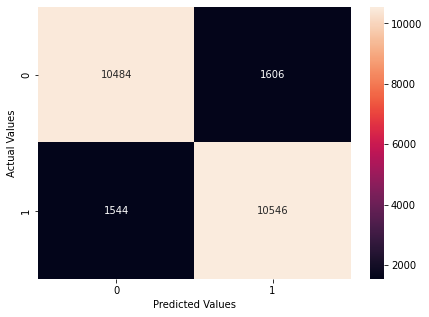

In [395]:
# Confusion matrix for undersampled train data
cm = confusion_matrix(y_train_over, lgr2.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

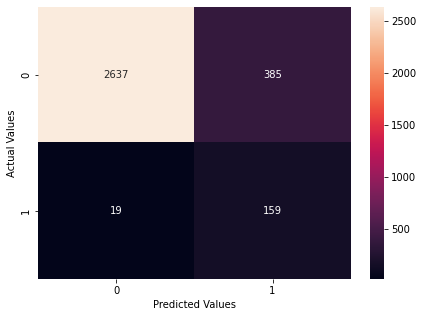

In [396]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, lgr2.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

### Tuning for Logistic Regression with original data

For Logistic Regression:
param_grid = {'C': np.arange(0.1,1.1,0.1)}

In [397]:
# defining model
Model = LogisticRegression(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'C': np.arange(0.1,1.1,0.1)}

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'C': 0.1} with CV score=0.476056338028169:


In [398]:
# Set the clf to the best combination of parameters
lgr1_tuned = LogisticRegression(    
    C=0.1,
)

# Fit the best algorithm to the data.
lgr1_tuned.fit(X_train, y_train)

LogisticRegression(C=0.1)

In [399]:
# to check performance of the model on the training data
lgr_tuned_default_model_train_perf = model_performance_classification_sklearn(
    lgr1_tuned, X_train, y_train
)
lgr_tuned_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.48,0.87,0.62


In [400]:
# to check performance of the model on the validation data
lgr_tuned_default_model_val_perf = model_performance_classification_sklearn(
    lgr1_tuned, X_val, y_val
)
lgr_tuned_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.50,0.83,0.62


* There is no improvement in recall performance when compared with the untuned default model

### Tuning for Random Forest with oversampled data

In [401]:
# defining model
Model = LogisticRegression(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'C': np.arange(0.1,1.1,0.1)}

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'C': 0.1} with CV score=0.8738626964433417:


In [402]:
# Set the clf to the best combination of parameters
lgr2_tuned = LogisticRegression(    
    C=0.1,
)

# Fit the best algorithm to the data.
lgr2_tuned.fit(X_train_over, y_train_over)

LogisticRegression(C=0.1)

In [403]:
# to check performance of the model on the training data
lgr_tuned_oversampled_model_train_perf = model_performance_classification_sklearn(
    lgr2_tuned, X_train, y_train
)
lgr_tuned_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.87,0.85,0.28,0.42


In [404]:
# to check performance of the model on the validation data
lgr_tuned_oversampled_model_val_perf = model_performance_classification_sklearn(
    lgr2_tuned, X_val, y_val
)
lgr_tuned_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.87,0.89,0.29,0.44


* There is no improvement in recall performance when compared with the untuned oversampled model

### Tuning for Random Forest with undersampled data

In [405]:
# defining model
Model = LogisticRegression(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'C': np.arange(0.1,1.1,0.1)}

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'C': 0.1} with CV score=0.847887323943662:


In [406]:
# Set the clf to the best combination of parameters
lgr3_tuned = LogisticRegression(    
    C=0.1,
)

# Fit the best algorithm to the data.
lgr3_tuned.fit(X_train_un, y_train_un)

LogisticRegression(C=0.1)

In [407]:
# to check performance of the model on the training data
lgr_tuned_undersampled_model_train_perf = model_performance_classification_sklearn(
    lgr3_tuned, X_train, y_train
)
lgr_tuned_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.87,0.85,0.27,0.41


In [408]:
# to check performance of the model on the validation data
lgr_tuned_undersampled_model_val_perf = model_performance_classification_sklearn(
    lgr3_tuned, X_val, y_val
)
lgr_tuned_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.87,0.89,0.29,0.44


## Logistic Regression Models Comparison

In [409]:
# training performance comparison

models_train_comp_df = pd.concat(
    [
        lgr_default_model_train_perf.T,
        lgr_oversampled_model_train_perf.T,
        lgr_undersampled_model_train_perf.T,
        lgr_tuned_default_model_train_perf.T,
        lgr_tuned_oversampled_model_train_perf.T,
        lgr_tuned_undersampled_model_train_perf.T,
    ],
    axis=1,
)
models_train_comp_df.columns = [
    "Default Logistic Regression",
    "Logistic Regression with oversampled data",
    "Logistic Regression with undersampled data",
    "Tuned Default Logistic Regression",
    "Tuned Logistic Regression with oversampled data",
    "Tuned Logistic Regression with undersampled data",
]
print("Training performance comparison:")
models_train_comp_df

Training performance comparison:


,Default Logistic Regression,Logistic Regression with oversampled data,Logistic Regression with undersampled data,Tuned Default Logistic Regression,Tuned Logistic Regression with oversampled data,Tuned Logistic Regression with undersampled data
Accuracy,0.97,0.87,0.87,0.97,0.87,0.87
Recall,0.48,0.85,0.85,0.48,0.85,0.85
Precision,0.86,0.28,0.27,0.87,0.28,0.27
F1,0.62,0.42,0.41,0.62,0.42,0.41


In [410]:
# Validation performance comparison

models_val_comp_df = pd.concat(
    [
        lgr_default_model_val_perf.T,
        lgr_oversampled_model_val_perf.T,
        lgr_undersampled_model_val_perf.T,
        lgr_tuned_default_model_val_perf.T,
        lgr_tuned_oversampled_model_val_perf.T,
        lgr_tuned_undersampled_model_val_perf.T,
    ],
    axis=1,
)
models_val_comp_df.columns = [
    "Default Logistic Regression",
    "Logistic Regression with oversampled data",
    "Logistic Regression with undersampled data",
    "Tuned Default Logistic Regression",
    "Tuned Logistic Regression with oversampled data",
    "Tuned Logistic Regression with undersampled data",
]
print("Validation performance comparison:")
models_val_comp_df

Validation performance comparison:


,Default Logistic Regression,Logistic Regression with oversampled data,Logistic Regression with undersampled data,Tuned Default Logistic Regression,Tuned Logistic Regression with oversampled data,Tuned Logistic Regression with undersampled data
Accuracy,0.97,0.87,0.87,0.97,0.87,0.87
Recall,0.50,0.89,0.89,0.50,0.89,0.89
Precision,0.83,0.29,0.29,0.83,0.29,0.29
F1,0.62,0.44,0.44,0.62,0.44,0.44


* The tuned and untuned oversampled and undersampled models have similar recall performances 
* As there nothing between the tuned and untuned oversampled and undersampled models `Logistic Regression model with undersampled data` will be selected as the logistic regression model
* Logistic Regression does not have feature importances

In [411]:
# to check performance of the model on the test data
lgr_undersampled_model_test_perf = model_performance_classification_sklearn(
    lgr2, X_test, y_test
)
lgr_undersampled_model_test_perf

,Accuracy,Recall,Precision,F1
0,0.86,0.86,0.26,0.41


* The selected logistic regression model recall performance is comparable to the the model's performance on validation data

Text(42.0, 0.5, 'Actual Values')

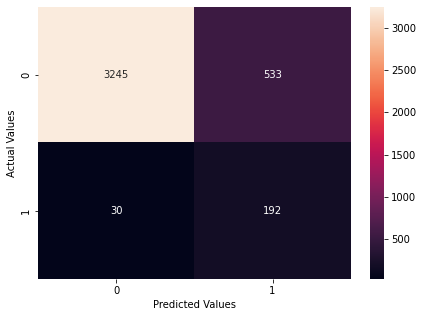

In [412]:
# Confusion matrix for the selected model on test data
cm = confusion_matrix(y_test, lgr2.predict(X_test))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

# AdaBoost Model Building

### Model Building with original data

In [413]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", AdaBoostClassifier(random_state=1)))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on training dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train, y_train)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on training dataset:

dtree: 0.5985915492957747

Validation Performance:

dtree: 0.6460674157303371


In [414]:
# to check performance of the model on training data
adb_default_model_train_perf = model_performance_classification_sklearn(
    model, X_train, y_train
)
adb_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.63,0.90,0.74


In [415]:
# to check performance of the model on validation data
adb_default_model_val_perf = model_performance_classification_sklearn(
    model, X_val, y_val
)
adb_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.65,0.90,0.75


* The model is generalizing well, however, the recall performance needs improvement 

### Model Building with Oversampled data


In [416]:
adb1 = AdaBoostClassifier(random_state=1)

# training the logistic regression model with oversampled training set
adb1.fit(X_train_over, y_train_over)

AdaBoostClassifier(random_state=1)

#### Checking performance of oversampled train and validation data

In [417]:
# to check performance of the model training data
adb_oversampled_model_train_perf = model_performance_classification_sklearn(
    adb1, X_train, y_train
)
adb_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.92,0.87,0.40,0.55


In [418]:
# to check performance of the model on the validation data
adb_oversampled_model_val_perf = model_performance_classification_sklearn(
    adb1, X_val, y_val
)
adb_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.92,0.86,0.39,0.54


Text(42.0, 0.5, 'Actual Values')

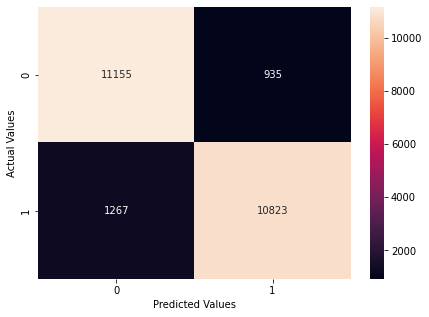

In [419]:
# Confusion matrix for oversampled train data
cm = confusion_matrix(y_train_over, adb1.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

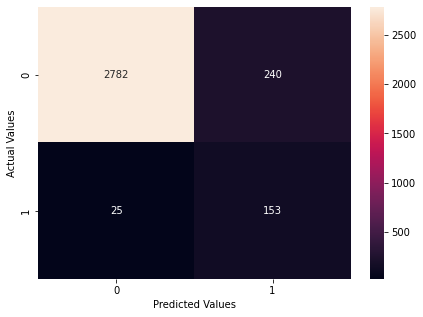

In [420]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, adb1.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* The oversampled model is not overfitting. The recall performance is higher than the default model

### Model Building with Undersampled data


In [421]:
adb2 = AdaBoostClassifier(random_state=1)

# training the logistic regression model with undersampled training set
adb2.fit(X_train_un, y_train_un)

AdaBoostClassifier(random_state=1)

#### Checking performance of oversampled train and validation data

In [422]:
# to check performance of the model training data
adb_undersampled_model_train_perf = model_performance_classification_sklearn(
    adb2, X_train, y_train
)
adb_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.89,0.90,0.32,0.47


In [423]:
# to check performance of the model on the validation data
adb_undersampled_model_val_perf = model_performance_classification_sklearn(
    adb2, X_val, y_val
)
adb_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.89,0.89,0.33,0.48


Text(42.0, 0.5, 'Actual Values')

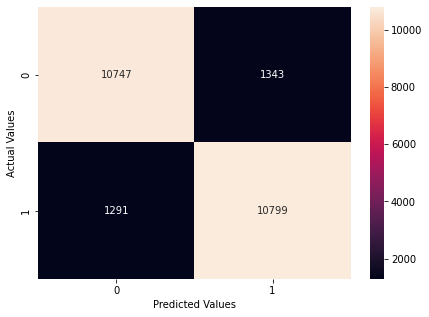

In [424]:
# Confusion matrix for undersampled train data
cm = confusion_matrix(y_train_over, adb2.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

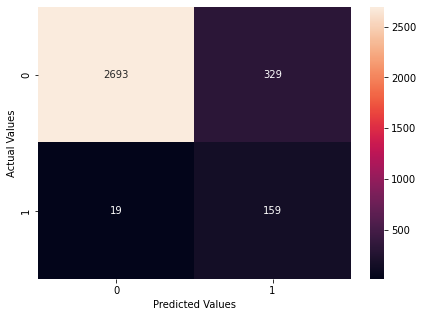

In [425]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, adb2.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* The umdersampled model is generalizing properly and the recall performance is better than both the default and oversampled models

### Tuning for AdaBoost with original data

For Adaboost:
param_grid = { "n_estimators": [100, 150, 200], "learning_rate": [0.2, 0.05], "base_estimator": [DecisionTreeClassifier(max_depth=1, random_state=1), DecisionTreeClassifier(max_depth=2, random_state=1), DecisionTreeClassifier(max_depth=3, random_state=1), ] }

In [426]:
# defining model
Model = AdaBoostClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [100,150,200],
              'learning_rate': [0.2, 0.05], 
              'base_estimator' : [DecisionTreeClassifier(max_depth=1, random_state=1),DecisionTreeClassifier(max_depth=2, random_state=1), DecisionTreeClassifier(max_depth=3, random_state=1), ]
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 200, 'learning_rate': 0.2, 'base_estimator': DecisionTreeClassifier(max_depth=3, random_state=1)} with CV score=0.7492957746478874:


In [427]:
# Set the clf to the best combination of parameters
adb1_tuned = AdaBoostClassifier(    
    n_estimators=200,
    learning_rate=0.2,
    base_estimator=DecisionTreeClassifier(max_depth=3, random_state=1),
)

# Fit the best algorithm to the data.
adb1_tuned.fit(X_train, y_train)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3,
                                                         random_state=1),
                   learning_rate=0.2, n_estimators=200)

In [428]:
# to check performance of the model on the training data
adb_tuned_default_model_train_perf = model_performance_classification_sklearn(
    adb1_tuned, X_train, y_train
)
adb_tuned_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,1.00,1.00,1.00,1.00


In [429]:
# to check performance of the model on the validation data
adb_tuned_default_model_val_perf = model_performance_classification_sklearn(
    adb1_tuned, X_val, y_val
)
adb_tuned_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.78,0.99,0.87


* The tuned oversampled model is overfitting on the training data

### Tuning for AdaBoost with oversampled data

In [430]:
# defining model
Model = AdaBoostClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [100,150,200],
              'learning_rate': [0.2, 0.05], 
              'base_estimator' : [DecisionTreeClassifier(max_depth=1, random_state=1),DecisionTreeClassifier(max_depth=2, random_state=1), DecisionTreeClassifier(max_depth=3, random_state=1), ]
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 200, 'learning_rate': 0.2, 'base_estimator': DecisionTreeClassifier(max_depth=3, random_state=1)} with CV score=0.9772539288668322:


In [431]:
# Set the clf to the best combination of parameters
adb2_tuned = AdaBoostClassifier(    
    n_estimators=200,
    learning_rate=0.2,
    base_estimator=DecisionTreeClassifier(max_depth=3, random_state=1),
)

# Fit the best algorithm to the data.
adb2_tuned.fit(X_train_over, y_train_over)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3,
                                                         random_state=1),
                   learning_rate=0.2, n_estimators=200)

In [432]:
# to check performance of the model on the training data
adb_tuned_oversampled_model_train_perf = model_performance_classification_sklearn(
    adb2_tuned, X_train, y_train
)
adb_tuned_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,1.00,1.00,0.94,0.97


In [433]:
# to check performance of the model on the validation data
adb_tuned_oversampled_model_val_perf = model_performance_classification_sklearn(
    adb2_tuned, X_val, y_val
)
adb_tuned_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.87,0.88,0.87


### Tuning for AdaBoost with undersampled data

In [434]:
# defining model
Model = AdaBoostClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [100,150,200],
              'learning_rate': [0.2, 0.05], 
              'base_estimator' : [DecisionTreeClassifier(max_depth=1, random_state=1),DecisionTreeClassifier(max_depth=2, random_state=1), DecisionTreeClassifier(max_depth=3, random_state=1), ]
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 200, 'learning_rate': 0.2, 'base_estimator': DecisionTreeClassifier(max_depth=3, random_state=1)} with CV score=0.8788732394366198:


In [435]:
# Set the clf to the best combination of parameters
adb3_tuned = AdaBoostClassifier(    
    n_estimators=200,
    learning_rate=0.2,
    base_estimator=DecisionTreeClassifier(max_depth=3, random_state=1),
)

# Fit the best algorithm to the data.
adb3_tuned.fit(X_train_un, y_train_un)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3,
                                                         random_state=1),
                   learning_rate=0.2, n_estimators=200)

In [436]:
# to check performance of the model on the training data
adb_tuned_undersampled_model_train_perf = model_performance_classification_sklearn(
    adb3_tuned, X_train, y_train
)
adb_tuned_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.94,1.00,0.48,0.64


In [437]:
# to check performance of the model on the validation data
adb_tuned_undersampled_model_val_perf = model_performance_classification_sklearn(
    adb3_tuned, X_val, y_val
)
adb_tuned_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.93,0.90,0.44,0.59


* The tuned undersampled model is also overfitting though it's recall performance is high

## AdaBoost Models Comparison

In [438]:
# training performance comparison

models_train_comp_df = pd.concat(
    [
        adb_default_model_train_perf.T,
        adb_oversampled_model_train_perf.T,
        adb_undersampled_model_train_perf.T,
        adb_tuned_default_model_train_perf.T,
        adb_tuned_oversampled_model_train_perf.T,
        adb_tuned_undersampled_model_train_perf.T,
    ],
    axis=1,
)
models_train_comp_df.columns = [
    "Default AdaBoost",
    "AdaBoost with oversampled data",
    "AdaBoost with undersampled data",
    "Tuned Default AdaBoost",
    "Tuned AdaBoost with oversampled data",
    "Tuned AdaBoost with undersampled data",
]
print("Training performance comparison:")
models_train_comp_df

Training performance comparison:


,Default AdaBoost,AdaBoost with oversampled data,AdaBoost with undersampled data,Tuned Default AdaBoost,Tuned AdaBoost with oversampled data,Tuned AdaBoost with undersampled data
Accuracy,0.98,0.92,0.89,1.00,1.00,0.94
Recall,0.63,0.87,0.90,1.00,1.00,1.00
Precision,0.90,0.40,0.32,1.00,0.94,0.48
F1,0.74,0.55,0.47,1.00,0.97,0.64


In [439]:
# Validation performance comparison

models_val_comp_df = pd.concat(
    [
        adb_default_model_val_perf.T,
        adb_oversampled_model_val_perf.T,
        adb_undersampled_model_val_perf.T,
        adb_tuned_default_model_val_perf.T,
        adb_tuned_oversampled_model_val_perf.T,
        adb_tuned_undersampled_model_val_perf.T,
    ],
    axis=1,
)
models_val_comp_df.columns = [
    "Default AdaBoost",
    "AdaBoost with oversampled data",
    "AdaBoost with undersampled data",
    "Tuned Default AdaBoost",
    "Tuned AdaBoost with oversampled data",
    "Tuned AdaBoost with undersampled data",
]
print("Validation performance comparison:")
models_val_comp_df

Validation performance comparison:


,Default AdaBoost,AdaBoost with oversampled data,AdaBoost with undersampled data,Tuned Default AdaBoost,Tuned AdaBoost with oversampled data,Tuned AdaBoost with undersampled data
Accuracy,0.98,0.92,0.89,0.99,0.99,0.93
Recall,0.65,0.86,0.89,0.78,0.87,0.90
Precision,0.90,0.39,0.33,0.99,0.88,0.44
F1,0.75,0.54,0.48,0.87,0.87,0.59


* The best performing models on the validation data are `Tuned AdaBoost with undersampled data` and `AdaBoost with undersampled data`. However, the former is overfitting on the training data
* Therefore, `AdaBoost with undersampled data` is the better model and the selected Adaboost model

In [440]:
# to check performance of the model on the test data
adb_undersampled_model_test_perf = model_performance_classification_sklearn(
    adb2, X_test, y_test
)
adb_undersampled_model_test_perf

,Accuracy,Recall,Precision,F1
0,0.88,0.86,0.31,0.45


* The recall performance of the selected AdaBoost model on the test data is slightly less than the performance on the validation data

Text(42.0, 0.5, 'Actual Values')

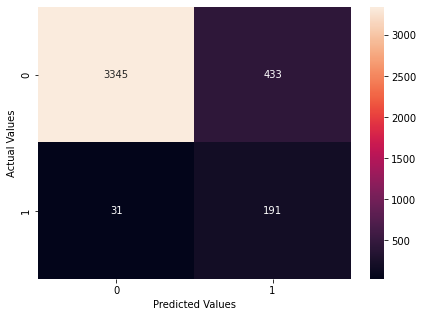

In [441]:
# Confusion matrix for the selected model on test data
cm = confusion_matrix(y_test, adb2.predict(X_test))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

In [442]:
# importance of features in the tree building

print(pd.DataFrame(adb2.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

     Imp
V18 0.08
V3  0.06
V37 0.06
V26 0.06
V30 0.06
V9  0.06
V2  0.06
V21 0.04
V23 0.04
V17 0.04
V14 0.04
V34 0.04
V12 0.04
V36 0.04
V24 0.02
V33 0.02
V32 0.02
V28 0.02
V25 0.02
V15 0.02
V20 0.02
V35 0.02
V13 0.02
V11 0.02
V10 0.02
V7  0.02
V38 0.02
V39 0.02
V31 0.00
V1  0.00
V29 0.00
V27 0.00
V22 0.00
V19 0.00
V16 0.00
V8  0.00
V6  0.00
V5  0.00
V4  0.00
V40 0.00


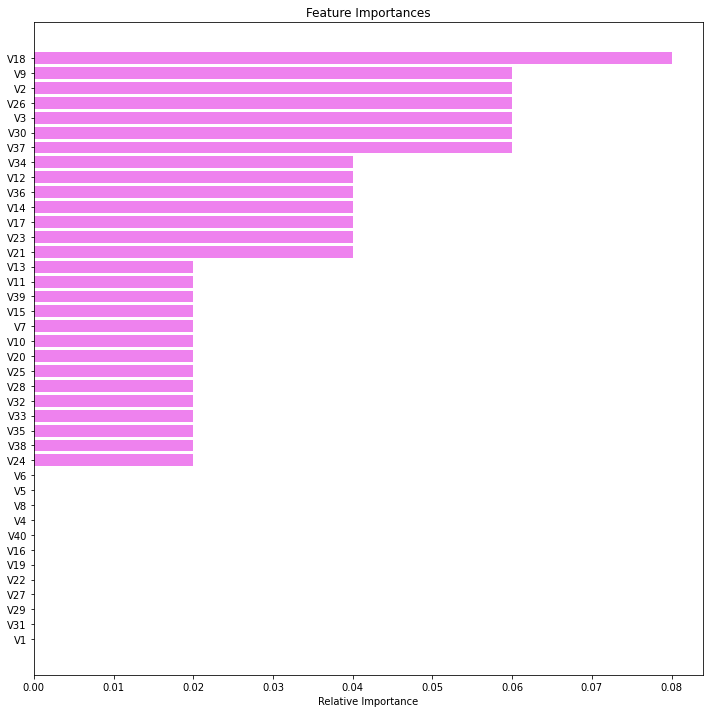

In [443]:
feature_names = X_train.columns
importances = adb2.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

* The most likely feature to cause failure based on the selected AdaBoost model is V18 with a probability of 8%
* Others significant features are V3,V37,V26,V30,V9,V2 with failure probability of 6% each.

# Gradient Boost Model Building

### Model Building with original data

In [444]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", GradientBoostingClassifier(random_state=1)))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on training dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train, y_train)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on training dataset:

dtree: 0.7028169014084507

Validation Performance:

dtree: 0.7640449438202247


In [445]:
# to check performance of the model on training data
grb_default_model_train_perf = model_performance_classification_sklearn(
    model, X_train, y_train
)
grb_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.83,0.99,0.90


In [446]:
# to check performance of the model on validation data
grb_default_model_val_perf = model_performance_classification_sklearn(
    model, X_val, y_val
)
grb_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.76,0.89,0.82


* The default model is overfitting

### Model Building with Oversampled data


In [447]:
grb1 = GradientBoostingClassifier(random_state=1)

# training the gradient boost model with oversampled training set
grb1.fit(X_train_over, y_train_over)

GradientBoostingClassifier(random_state=1)

#### Checking performance of oversampled train and validation data

In [448]:
# to check performance of the model training data
grb_oversampled_model_train_perf = model_performance_classification_sklearn(
    grb1, X_train, y_train
)
grb_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.91,0.68,0.78


In [449]:
# to check performance of the model on the validation data
grb_oversampled_model_val_perf = model_performance_classification_sklearn(
    grb1, X_val, y_val
)
grb_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.90,0.69,0.78


Text(42.0, 0.5, 'Actual Values')

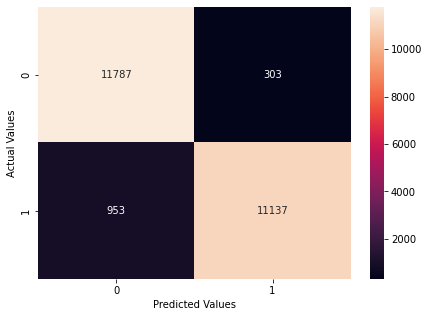

In [450]:
# Confusion matrix for oversampled train data
cm = confusion_matrix(y_train_over, grb1.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

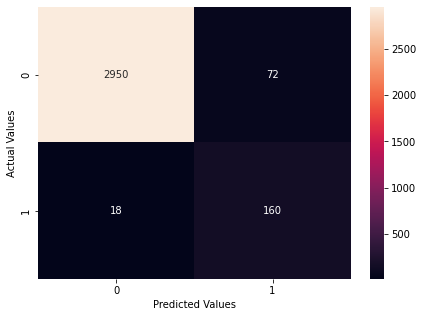

In [451]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, grb1.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

### Model Building with Undersampled data


In [452]:
grb2 = GradientBoostingClassifier(random_state=1)

# training the gradient boost model with undersampled training set
grb2.fit(X_train_un, y_train_un)

GradientBoostingClassifier(random_state=1)

#### Checking performance of undersampled train and validation data

In [453]:
# to check performance of the model training data
grb_undersampled_model_train_perf = model_performance_classification_sklearn(
    grb2, X_train, y_train
)
grb_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.95,0.95,0.53,0.68


In [454]:
# to check performance of the model on the validation data
grb_undersampled_model_val_perf = model_performance_classification_sklearn(
    grb2, X_val, y_val
)
grb_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.95,0.90,0.52,0.66


Text(42.0, 0.5, 'Actual Values')

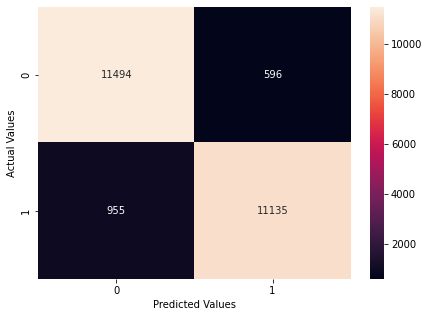

In [455]:
# Confusion matrix for undersampled train data
cm = confusion_matrix(y_train_over, grb2.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

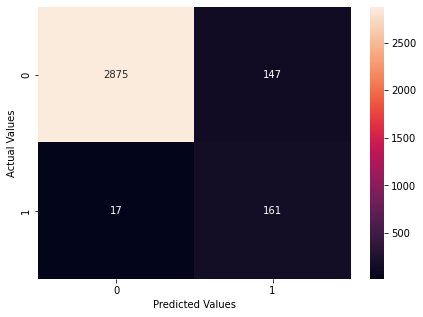

In [456]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, grb2.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* The undersampled model's recall performance is similar to the oversampled model

### Tuning for Gradient Boost with original data

For Gradient Boosting:
param_grid = { "n_estimators": np.arange(100,150,25), "learning_rate": [0.2, 0.05, 1], "subsample":[0.5,0.7], "max_features":[0.5,0.7] }

In [457]:
# defining model
Model = GradientBoostingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [100,150,25],
              'learning_rate': [0.2, 0.05,1], 
              'subsample' : [0.5,0.7],
              'max_features' : [0.5,0.7],
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'subsample': 0.7, 'n_estimators': 150, 'max_features': 0.5, 'learning_rate': 0.2} with CV score=0.7436619718309859:


In [458]:
# Set the clf to the best combination of parameters
grb1_tuned = GradientBoostingClassifier(    
    n_estimators=150,
    subsample=0.7,
    max_features=0.5,
    learning_rate=0.2,
)

# Fit the best algorithm to the data.
grb1_tuned.fit(X_train, y_train)

GradientBoostingClassifier(learning_rate=0.2, max_features=0.5,
                           n_estimators=150, subsample=0.7)

In [459]:
# to check performance of the model on the training data
grb_tuned_default_model_train_perf = model_performance_classification_sklearn(
    grb1_tuned, X_train, y_train
)
grb_tuned_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,1.00,0.95,0.99,0.97


In [460]:
# to check performance of the model on the validation data
grb_tuned_default_model_val_perf = model_performance_classification_sklearn(
    grb1_tuned, X_val, y_val
)
grb_tuned_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.80,0.87,0.83


The tuned default model is overfitting 

### Tuning for Gradient Boost with oversampled data

In [461]:
# defining model
Model = GradientBoostingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [100,150,25],
              'learning_rate': [0.2, 0.05,1], 
              'subsample' : [0.5,0.7],
              'max_features' : [0.5,0.7],
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'subsample': 0.5, 'n_estimators': 100, 'max_features': 0.7, 'learning_rate': 1} with CV score=0.9640198511166254:


In [462]:
# Set the clf to the best combination of parameters
grb2_tuned = GradientBoostingClassifier(    
    n_estimators=100,
    subsample=0.5,
    max_features=0.7,
    learning_rate=1,
)

# Fit the best algorithm to the data.
grb2_tuned.fit(X_train_over, y_train_over)

GradientBoostingClassifier(learning_rate=1, max_features=0.7, subsample=0.5)

In [463]:
# to check performance of the model on the training data
grb_tuned_oversampled_model_train_perf = model_performance_classification_sklearn(
    grb2_tuned, X_train, y_train
)
grb_tuned_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.98,0.78,0.87


In [464]:
# to check performance of the model on the validation data
grb_tuned_oversampled_model_val_perf = model_performance_classification_sklearn(
    grb2_tuned, X_val, y_val
)
grb_tuned_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.96,0.87,0.58,0.70


The tuned oversampled model is also overfitting

### Tuning for Gradient Boost with undersampled data

In [465]:
# defining model
Model = GradientBoostingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [100,150,25],
              'learning_rate': [0.2, 0.05,1], 
              'subsample' : [0.5,0.7],
              'max_features' : [0.5,0.7],
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'subsample': 0.7, 'n_estimators': 150, 'max_features': 0.5, 'learning_rate': 0.2} with CV score=0.8859154929577466:


In [466]:
# Set the clf to the best combination of parameters
grb3_tuned = GradientBoostingClassifier(    
    n_estimators=150,
    subsample=0.7,
    max_features=0.5,
    learning_rate=0.2,
)

# Fit the best algorithm to the data.
grb3_tuned.fit(X_train_un, y_train_un)

GradientBoostingClassifier(learning_rate=0.2, max_features=0.5,
                           n_estimators=150, subsample=0.7)

In [467]:
# to check performance of the model on the training data
grb_tuned_undersampled_model_train_perf = model_performance_classification_sklearn(
    grb3_tuned, X_train, y_train
)
grb_tuned_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.95,1.00,0.55,0.71


In [468]:
# to check performance of the model on the validation data
grb_tuned_undersampled_model_val_perf = model_performance_classification_sklearn(
    grb3_tuned, X_val, y_val
)
grb_tuned_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.95,0.91,0.51,0.65


* The tuned undersampled model is overfitting more than the untuned undersampled model

## Gradient Boost Models Comparison

In [469]:
# training performance comparison

models_train_comp_df = pd.concat(
    [
        grb_default_model_train_perf.T,
        grb_oversampled_model_train_perf.T,
        grb_undersampled_model_train_perf.T,
        grb_tuned_default_model_train_perf.T,
        grb_tuned_oversampled_model_train_perf.T,
        grb_tuned_undersampled_model_train_perf.T,
    ],
    axis=1,
)
models_train_comp_df.columns = [
    "Default Gradient Boost",
    "Gradient Boost with oversampled data",
    "Gradient Boost with undersampled data",
    "Tuned Default Gradient Boost",
    "Tuned Gradient Boost with oversampled data",
    "Tuned Gradient Boost with undersampled data",
]
print("Training performance comparison:")
models_train_comp_df

Training performance comparison:


,Default Gradient Boost,Gradient Boost with oversampled data,Gradient Boost with undersampled data,Tuned Default Gradient Boost,Tuned Gradient Boost with oversampled data,Tuned Gradient Boost with undersampled data
Accuracy,0.99,0.97,0.95,1.00,0.98,0.95
Recall,0.83,0.91,0.95,0.95,0.98,1.00
Precision,0.99,0.68,0.53,0.99,0.78,0.55
F1,0.90,0.78,0.68,0.97,0.87,0.71


In [470]:
# Validation performance comparison

models_val_comp_df = pd.concat(
    [
        grb_default_model_val_perf.T,
        grb_oversampled_model_val_perf.T,
        grb_undersampled_model_val_perf.T,
        grb_tuned_default_model_val_perf.T,
        grb_tuned_oversampled_model_val_perf.T,
        grb_tuned_undersampled_model_val_perf.T,
    ],
    axis=1,
)
models_val_comp_df.columns = [
    "Default Gradient Boost",
    "Gradient Boost with oversampled data",
    "Gradient Boost with undersampled data",
    "Tuned Default Gradient Boost",
    "Tuned Gradient Boost with oversampled data",
    "Tuned Gradient Boost with undersampled data",
]
print("Validation performance comparison:")
models_val_comp_df

Validation performance comparison:


,Default Gradient Boost,Gradient Boost with oversampled data,Gradient Boost with undersampled data,Tuned Default Gradient Boost,Tuned Gradient Boost with oversampled data,Tuned Gradient Boost with undersampled data
Accuracy,0.98,0.97,0.95,0.98,0.96,0.95
Recall,0.76,0.90,0.90,0.80,0.87,0.91
Precision,0.89,0.69,0.52,0.87,0.58,0.51
F1,0.82,0.78,0.66,0.83,0.70,0.65


* The best performing models on the validation data are `Untuned Gradient Boost with overersampled data` and `Untuned Gradient Boost with undersampled data`

* `Untuned Gradient Boost with overersampled data` model is the selected model because it generalizes better

In [471]:
# to check performance of the model on the test data
grb_oversampled_model_test_perf = model_performance_classification_sklearn(
    grb1, X_test, y_test
)
grb_oversampled_model_test_perf

,Accuracy,Recall,Precision,F1
0,0.96,0.86,0.63,0.73


* The performance of the model on the test data is not as high as the performance on the validation data. However, it is comparable to the performance of previous models

Text(42.0, 0.5, 'Actual Values')

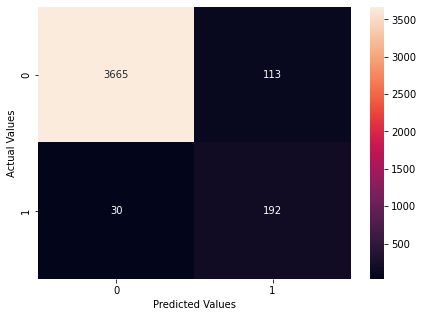

In [472]:
# Confusion matrix for the selected model on test data
cm = confusion_matrix(y_test, grb1.predict(X_test))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

In [473]:
# importance of features in the tree building

print(pd.DataFrame(grb1.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

     Imp
V36 0.26
V18 0.17
V14 0.09
V39 0.09
V26 0.06
V16 0.05
V9  0.04
V3  0.03
V15 0.02
V12 0.02
V35 0.02
V7  0.01
V10 0.01
V37 0.01
V1  0.01
V34 0.01
V38 0.01
V21 0.01
V27 0.01
V30 0.01
V11 0.01
V33 0.01
V5  0.01
V6  0.00
V13 0.00
V32 0.00
V4  0.00
V17 0.00
V24 0.00
V40 0.00
V2  0.00
V20 0.00
V28 0.00
V22 0.00
V29 0.00
V8  0.00
V31 0.00
V23 0.00
V19 0.00
V25 0.00


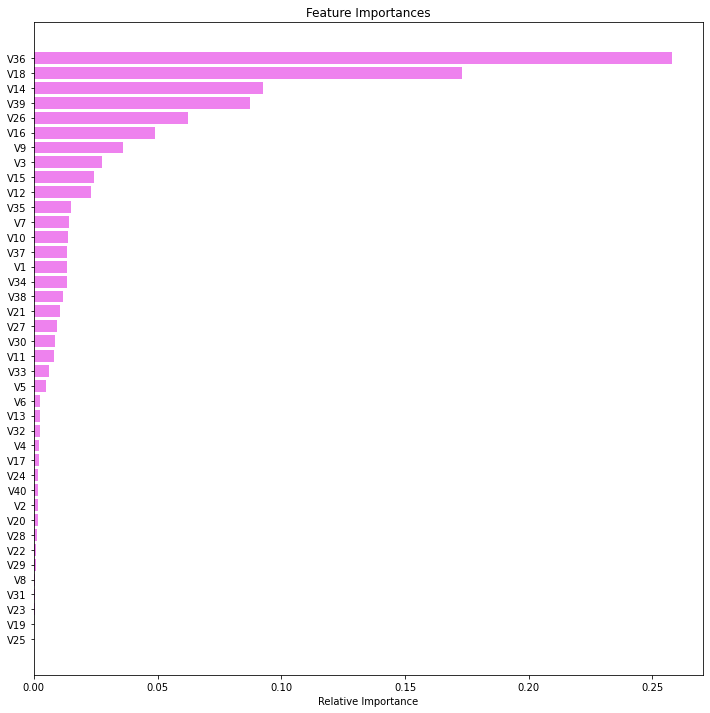

In [474]:
feature_names = X_train.columns
importances = grb1.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

* The most likely feature to cause failure based on the selected Gradient Boost model is V36 with a probability of 26%, followed by V18 with 19%
* Others significant features are V14,V39 with failure probability of 9% each.

# XGBoost Model Building

### Model Building with original data

In [475]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", XGBClassifier(random_state=1)))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on training dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train, y_train)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on training dataset:

dtree: 0.719718309859155

Validation Performance:

dtree: 0.7752808988764045


In [476]:
# to check performance of the model on training data
xgb_default_model_train_perf = model_performance_classification_sklearn(
    model, X_train, y_train
)
xgb_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.81,0.99,0.89


In [477]:
# to check performance of the model on validation data
xgb_default_model_val_perf = model_performance_classification_sklearn(
    model, X_val, y_val
)
xgb_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.78,0.98,0.87


* The default model is not overfitting on the training data.


### Model Building with Oversampled data


In [478]:
xgb1 = XGBClassifier(random_state=1)

# training the gradient boost model with oversampled training set
xgb1.fit(X_train_over, y_train_over)

XGBClassifier(random_state=1)

#### Checking performance of oversampled train and validation data

In [479]:
# to check performance of the model training data
xgb_oversampled_model_train_perf = model_performance_classification_sklearn(
    xgb1, X_train, y_train
)
xgb_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.90,0.69,0.79


In [480]:
# to check performance of the model on the validation data
xgb_oversampled_model_val_perf = model_performance_classification_sklearn(
    xgb1, X_val, y_val
)
xgb_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.89,0.70,0.78


Text(42.0, 0.5, 'Actual Values')

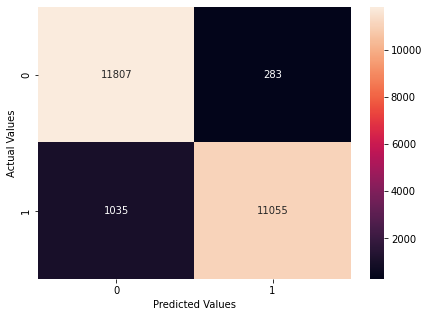

In [481]:
# Confusion matrix for oversampled train data
cm = confusion_matrix(y_train_over, xgb1.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

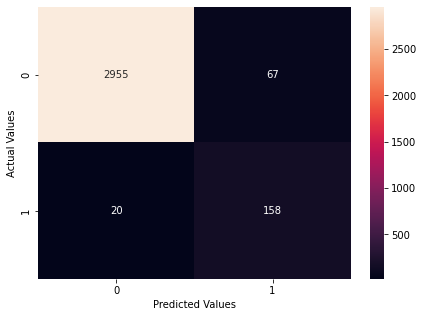

In [482]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, xgb1.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

### Model Building with Undersampled data


In [483]:
xgb2 = XGBClassifier(random_state=1)

# training the gradient boost model with undersampled training set
xgb2.fit(X_train_un, y_train_un)

XGBClassifier(random_state=1)

#### Checking performance of undersampled train and validation data

In [484]:
# to check performance of the model training data
xgb_undersampled_model_train_perf = model_performance_classification_sklearn(
    xgb2, X_train, y_train
)
xgb_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.95,0.93,0.54,0.68


In [485]:
# to check performance of the model on the validation data
xgb_undersampled_model_val_perf = model_performance_classification_sklearn(
    xgb2, X_val, y_val
)
xgb_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.96,0.90,0.59,0.71


Text(42.0, 0.5, 'Actual Values')

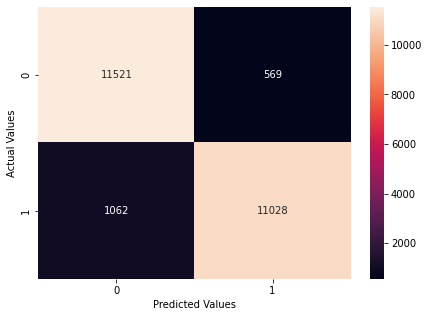

In [486]:
# Confusion matrix for undersampled train data
cm = confusion_matrix(y_train_over, xgb2.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

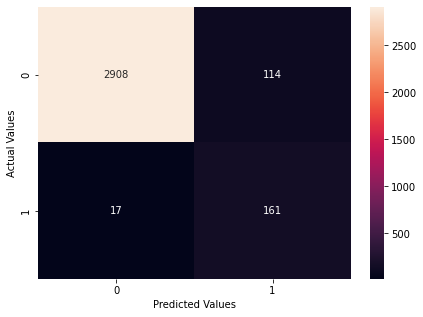

In [487]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, xgb2.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* The model is not overfitting on the training data

### Tuning for XGBoost with original data

For XGBoost:
param_grid={ 'n_estimators': [150, 200, 250], 'scale_pos_weight': [5,10], 'learning_rate': [0.1,0.2], 'gamma': [0,3,5], 'subsample': [0.8,0.9] }

In [488]:
# defining model
Model = XGBClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [150,200,250],
              'learning_rate': [0.1, 0.2], 
              'subsample' : [0.8,0.9],
              'scale_pos_weight' : [5,10],
              'gamma' : [0,3,5],
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'subsample': 0.9, 'scale_pos_weight': 10, 'n_estimators': 200, 'learning_rate': 0.1, 'gamma': 5} with CV score=0.8507042253521127:


In [489]:
# Set the clf to the best combination of parameters
xgb1_tuned = XGBClassifier(    
    n_estimators=200,
    subsample=0.9,
    scale_pos_weight=10,
    learning_rate=0.1,
    gamma=5,
)

# Fit the best algorithm to the data.
xgb1_tuned.fit(X_train, y_train)

XGBClassifier(gamma=5, n_estimators=200, scale_pos_weight=10, subsample=0.9)

In [490]:
# to check performance of the model on the training data
xgb_tuned_default_model_train_perf = model_performance_classification_sklearn(
    xgb1_tuned, X_train, y_train
)
xgb_tuned_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.97,0.91,0.93


In [491]:
# to check performance of the model on the validation data
xgb_tuned_default_model_val_perf = model_performance_classification_sklearn(
    grb1_tuned, X_val, y_val
)
xgb_tuned_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.80,0.87,0.83


The tuned default model is overfitting

### Tuning for XGBoost with oversampled data

In [492]:
# defining model
Model = XGBClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [150,200,250],
              'learning_rate': [0.1, 0.2], 
              'subsample' : [0.8,0.9],
              'scale_pos_weight' : [5,10],
              'gamma' : [0,3,5],
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'subsample': 0.9, 'scale_pos_weight': 10, 'n_estimators': 200, 'learning_rate': 0.2, 'gamma': 0} with CV score=0.9941273779983458:


In [493]:
# Set the clf to the best combination of parameters
xgb2_tuned = XGBClassifier(    
    n_estimators=200,
    subsample=0.9,
    scale_pos_weight=10,
    learning_rate=0.2,
    gamma=0,
)

# Fit the best algorithm to the data.
xgb2_tuned.fit(X_train_over, y_train_over)

XGBClassifier(learning_rate=0.2, n_estimators=200, scale_pos_weight=10,
              subsample=0.9)

In [494]:
# to check performance of the model on the training data
xgb_tuned_oversampled_model_train_perf = model_performance_classification_sklearn(
    xgb2_tuned, X_train, y_train
)
xgb_tuned_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.94,1.00,0.50,0.66


In [495]:
# to check performance of the model on the validation data
xgb_tuned_oversampled_model_val_perf = model_performance_classification_sklearn(
    xgb2_tuned, X_val, y_val
)
xgb_tuned_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.93,0.92,0.42,0.58


* The tuned oversampled model is slightly overfitting on the training model

### Tuning for Gradient Boost with undersampled data

In [496]:
# defining model
Model = XGBClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'n_estimators': [150,200,250],
              'learning_rate': [0.1, 0.2], 
              'subsample' : [0.8,0.9],
              'scale_pos_weight' : [5,10],
              'gamma' : [0,3,5],
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'subsample': 0.9, 'scale_pos_weight': 10, 'n_estimators': 200, 'learning_rate': 0.1, 'gamma': 5} with CV score=0.9225352112676056:


In [497]:
# Set the clf to the best combination of parameters
xgb3_tuned = XGBClassifier(    
    n_estimators=200,
    subsample=0.9,
    scale_pos_weight=10,
    learning_rate=0.1,
    gamma=5,
)

# Fit the best algorithm to the data.
xgb3_tuned.fit(X_train_un, y_train_un)

XGBClassifier(gamma=5, n_estimators=200, scale_pos_weight=10, subsample=0.9)

In [498]:
# to check performance of the model on the training data
xgb_tuned_undersampled_model_train_perf = model_performance_classification_sklearn(
    xgb3_tuned, X_train, y_train
)
xgb_tuned_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.84,1.00,0.26,0.41


In [499]:
# to check performance of the model on the validation data
xgb_tuned_undersampled_model_val_perf = model_performance_classification_sklearn(
    xgb3_tuned, X_val, y_val
)
xgb_tuned_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.83,0.94,0.24,0.39


* The recall performance of the tuned undersampled model is the highest for the XGBoost model. 
* The model is slightly overfitting on the training data

## XGBoost Models Comparison

In [500]:
# training performance comparison

models_train_comp_df = pd.concat(
    [
        xgb_default_model_train_perf.T,
        xgb_oversampled_model_train_perf.T,
        xgb_undersampled_model_train_perf.T,
        xgb_tuned_default_model_train_perf.T,
        xgb_tuned_oversampled_model_train_perf.T,
        xgb_tuned_undersampled_model_train_perf.T,
    ],
    axis=1,
)
models_train_comp_df.columns = [
    "Default XGBoost",
    "XGBoost with oversampled data",
    "XGBoost with undersampled data",
    "Tuned Default XGBoost",
    "Tuned XGBoost with oversampled data",
    "Tuned XGBoost with undersampled data",
]
print("Training performance comparison:")
models_train_comp_df

Training performance comparison:


,Default XGBoost,XGBoost with oversampled data,XGBoost with undersampled data,Tuned Default XGBoost,Tuned XGBoost with oversampled data,Tuned XGBoost with undersampled data
Accuracy,0.99,0.97,0.95,0.99,0.94,0.84
Recall,0.81,0.90,0.93,0.97,1.00,1.00
Precision,0.99,0.69,0.54,0.91,0.50,0.26
F1,0.89,0.79,0.68,0.93,0.66,0.41


In [501]:
# Validation performance comparison

models_val_comp_df = pd.concat(
    [
        xgb_default_model_val_perf.T,
        xgb_oversampled_model_val_perf.T,
        xgb_undersampled_model_val_perf.T,
        xgb_tuned_default_model_val_perf.T,
        xgb_tuned_oversampled_model_val_perf.T,
        xgb_tuned_undersampled_model_val_perf.T,
    ],
    axis=1,
)
models_val_comp_df.columns = [
    "Default XGBoost",
    "XGBoost with oversampled data",
    "XGBoost with undersampled data",
    "Tuned Default XGBoost",
    "Tuned XGBoost with oversampled data",
    "Tuned XGBoost with undersampled data",
]
print("Validation performance comparison:")
models_val_comp_df

Validation performance comparison:


,Default XGBoost,XGBoost with oversampled data,XGBoost with undersampled data,Tuned Default XGBoost,Tuned XGBoost with oversampled data,Tuned XGBoost with undersampled data
Accuracy,0.99,0.97,0.96,0.98,0.93,0.83
Recall,0.78,0.89,0.90,0.80,0.92,0.94
Precision,0.98,0.70,0.59,0.87,0.42,0.24
F1,0.87,0.78,0.71,0.83,0.58,0.39


* The best performing models on the validation data are `Untuned XGBoost model with undersampled data` and `Tuned XGBoost model with undersampled data`

* `Untuned XGBoost model with undersampled data` model is the selected model because it generalizes better

In [502]:
# to check performance of the model on the test data
xgb_undersampled_model_test_perf = model_performance_classification_sklearn(
    xgb2, X_test, y_test
)
xgb_undersampled_model_test_perf

,Accuracy,Recall,Precision,F1
0,0.94,0.87,0.49,0.63


* The model performance is similar to previous models but lower than the model's performance on validation data

Text(42.0, 0.5, 'Actual Values')

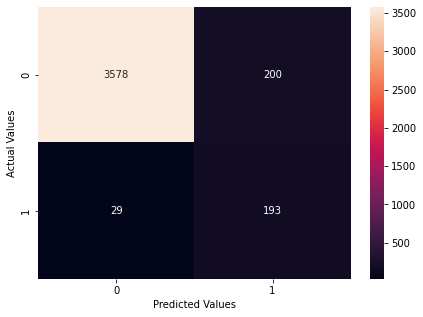

In [503]:
# Confusion matrix for the selected model on test data
cm = confusion_matrix(y_test, xgb2.predict(X_test))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

In [504]:
# importance of features in the tree building

print(pd.DataFrame(xgb2.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

     Imp
V18 0.14
V36 0.10
V39 0.09
V14 0.06
V3  0.04
V26 0.04
V40 0.04
V11 0.03
V16 0.03
V12 0.02
V35 0.02
V15 0.02
V1  0.02
V27 0.02
V8  0.02
V37 0.02
V25 0.02
V38 0.02
V20 0.02
V9  0.02
V33 0.01
V13 0.01
V10 0.01
V5  0.01
V30 0.01
V29 0.01
V19 0.01
V34 0.01
V21 0.01
V24 0.01
V31 0.01
V7  0.01
V4  0.01
V28 0.01
V6  0.01
V22 0.01
V2  0.01
V23 0.01
V17 0.01
V32 0.01


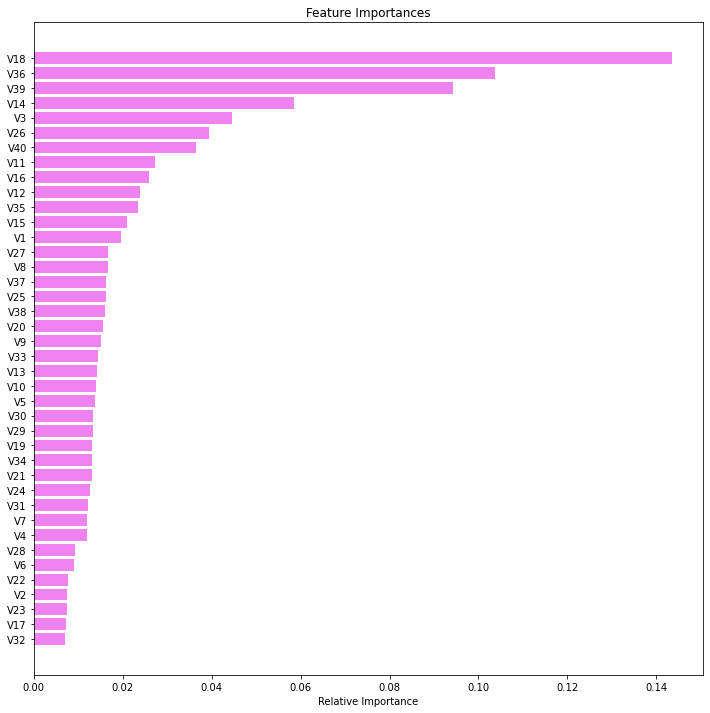

In [505]:
feature_names = X_train.columns
importances = xgb2.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

* The most likely feature to cause failure based on the selected Gradient Boost model is V18 with a probability of 14%, followed by V36 with 10%
* Others significant features are V39,V14 with failure probability of 9% and 6% respectively.

# Bagging Classifier Model Building

### Model Building with original data

In [506]:
models = []  # Empty list to store all the models

# Appending models into the list
models.append(("dtree", BaggingClassifier(random_state=1)))

results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation performance on training dataset:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train, y_train)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))


Cross-Validation performance on training dataset:

dtree: 0.7014084507042254

Validation Performance:

dtree: 0.6966292134831461


In [507]:
# to check performance of the model on training data
bgc_default_model_train_perf = model_performance_classification_sklearn(
    model, X_train, y_train
)
bgc_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,1.00,0.96,1.00,0.98


In [508]:
# to check performance of the model on validation data
bgc_default_model_val_perf = model_performance_classification_sklearn(
    model, X_val, y_val
)
bgc_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.70,0.97,0.81


The default model is overfitting

### Model Building with Oversampled data

In [509]:
bgc1 = BaggingClassifier(random_state=1)

# training the gradient boost model with oversampled training set
bgc1.fit(X_train_over, y_train_over)

BaggingClassifier(random_state=1)

#### Checking performance of oversampled train and validation data

In [510]:
# to check performance of the model training data
bgc_oversampled_model_train_perf = model_performance_classification_sklearn(
    bgc1, X_train, y_train
)
bgc_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,1.00,1.00,0.99,1.00


In [511]:
# to check performance of the model on the validation data
bgc_oversampled_model_val_perf = model_performance_classification_sklearn(
    bgc1, X_val, y_val
)
bgc_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.81,0.84,0.83


Text(42.0, 0.5, 'Actual Values')

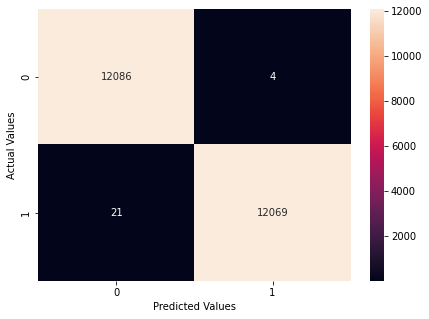

In [512]:
# Confusion matrix for oversampled train data
cm = confusion_matrix(y_train_over, bgc1.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

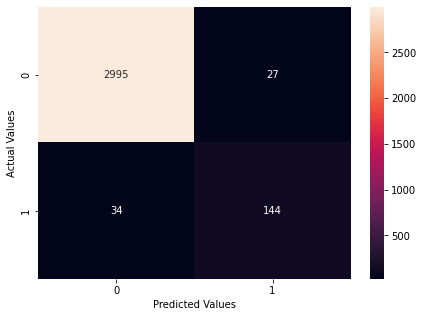

In [513]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, bgc1.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

The oversampled model is also overfitting

### Model Building with Undersampled data

In [514]:
bgc2 = BaggingClassifier(random_state=1)

# training the gradient boost model with undersampled training set
bgc2.fit(X_train_un, y_train_un)

BaggingClassifier(random_state=1)

#### Checking performance of undersampled train and validation data

In [515]:
# to check performance of the model training data
bgc_undersampled_model_train_perf = model_performance_classification_sklearn(
    bgc2, X_train, y_train
)
bgc_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.95,0.98,0.52,0.68


In [516]:
# to check performance of the model on the validation data
bgc_undersampled_model_val_perf = model_performance_classification_sklearn(
    bgc2, X_val, y_val
)
bgc_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.94,0.87,0.48,0.62


Text(42.0, 0.5, 'Actual Values')

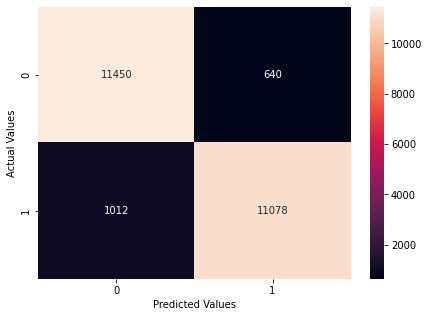

In [517]:
# Confusion matrix for undersampled train data
cm = confusion_matrix(y_train_over, bgc2.predict(X_train_over))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

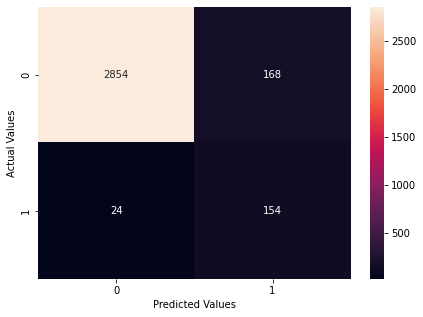

In [518]:
# Confusion matrix for validation data
cm = confusion_matrix(y_val, bgc2.predict(X_val))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")
plt.show()

* The model is also overfitting on the training data

### Tuning for Bagging Classifier with original data

For Bagging Classifier:
param_grid = { 'max_samples': [0.8,0.9,1], 'max_features': [0.7,0.8,0.9], 'n_estimators' : [30,50,70], }

In [519]:
# defining model
Model = BaggingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_samples': [0.8,0.9,1],
              'max_features': [0.7,0.8,0.9], 
              'n_estimators' : [30,50,70],
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train,y_train)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 70, 'max_samples': 0.9, 'max_features': 0.9} with CV score=0.7295774647887323:


In [520]:
# Set the clf to the best combination of parameters
bgc1_tuned = XGBClassifier(    
    n_estimators=70,
    max_features=0.9,
    max_samples=0.9,
)

# Fit the best algorithm to the data.
bgc1_tuned.fit(X_train, y_train)

XGBClassifier(max_features=0.9, max_samples=0.9, n_estimators=70)

In [521]:
# to check performance of the model on the training data
bgc_tuned_default_model_train_perf = model_performance_classification_sklearn(
    bgc1_tuned, X_train, y_train
)
bgc_tuned_default_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.99,0.77,0.99,0.87


In [522]:
# to check performance of the model on the validation data
bgc_tuned_default_model_val_perf = model_performance_classification_sklearn(
    bgc1_tuned, X_val, y_val
)
bgc_tuned_default_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.98,0.74,0.98,0.84


* The tuned default model is not overfitting however, the recall performance is not as high as other bagging classifier models

### Tuning for Bagging Classifier with oversampled data

In [523]:
# defining model
Model = BaggingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_samples': [0.8,0.9,1],
              'max_features': [0.7,0.8,0.9], 
              'n_estimators' : [30,50,70],
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_over,y_train_over)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 70, 'max_samples': 0.9, 'max_features': 0.8} with CV score=0.9825475599669147:


In [524]:
# Set the clf to the best combination of parameters
bgc2_tuned = XGBClassifier(    
    n_estimators=70,
    max_features=0.8,
    max_samples=0.9,
)

# Fit the best algorithm to the data.
bgc2_tuned.fit(X_train_over, y_train_over)

XGBClassifier(max_features=0.8, max_samples=0.9, n_estimators=70)

In [525]:
# to check performance of the model on the training data
bgc_tuned_oversampled_model_train_perf = model_performance_classification_sklearn(
    bgc2_tuned, X_train, y_train
)
bgc_tuned_oversampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.96,0.90,0.63,0.74


In [526]:
# to check performance of the model on the validation data
bgc_tuned_oversampled_model_val_perf = model_performance_classification_sklearn(
    bgc2_tuned, X_val, y_val
)
bgc_tuned_oversampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.97,0.88,0.67,0.76


* The model is not overfitting on the training data. The recall performance is comparable to previous models

### Tuning for Bagging Classifier with undersampled data

In [527]:
# defining model
Model = BaggingClassifier(random_state=1)

# Parameter grid to pass in RandomSearchCV
param_grid = {'max_samples': [0.8,0.9,1],
              'max_features': [0.7,0.8,0.9], 
              'n_estimators' : [30,50,70],
               }

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  

#Calling RandomizedSearchCV
randomized_cv = RandomizedSearchCV(estimator=Model, param_distributions=param_grid, n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

#Fitting parameters in RandomizedSearchCV
randomized_cv.fit(X_train_un,y_train_un)

print("Best parameters are {} with CV score={}:" .format(randomized_cv.best_params_,randomized_cv.best_score_))

Best parameters are {'n_estimators': 70, 'max_samples': 0.9, 'max_features': 0.9} with CV score=0.8704225352112676:


In [528]:
# Set the clf to the best combination of parameters
bgc3_tuned = XGBClassifier(    
    n_estimators=70,
    max_features=0.9,
    max_samples=0.9,
)

# Fit the best algorithm to the data.
bgc3_tuned.fit(X_train_un, y_train_un)

XGBClassifier(max_features=0.9, max_samples=0.9, n_estimators=70)

In [529]:
# to check performance of the model on the training data
bgc_tuned_undersampled_model_train_perf = model_performance_classification_sklearn(
    bgc3_tuned, X_train, y_train
)
bgc_tuned_undersampled_model_train_perf

,Accuracy,Recall,Precision,F1
0,0.95,0.91,0.50,0.65


In [530]:
# to check performance of the model on the validation data
bgc_tuned_undersampled_model_val_perf = model_performance_classification_sklearn(
    bgc3_tuned, X_val, y_val
)
bgc_tuned_undersampled_model_val_perf

,Accuracy,Recall,Precision,F1
0,0.95,0.89,0.54,0.67


* The model is not overfitting and the recall performance is comparable to the best bagging classifier models

## Bagging Classifier Models Comparison

In [531]:
# training performance comparison

models_train_comp_df = pd.concat(
    [
        bgc_default_model_train_perf.T,
        bgc_oversampled_model_train_perf.T,
        bgc_undersampled_model_train_perf.T,
        bgc_tuned_default_model_train_perf.T,
        bgc_tuned_oversampled_model_train_perf.T,
        bgc_tuned_undersampled_model_train_perf.T,
    ],
    axis=1,
)
models_train_comp_df.columns = [
    "Default Bagging Classifier",
    "Bagging Classifier with oversampled data",
    "Bagging Classifier with undersampled data",
    "Tuned Default Bagging Classifier",
    "Tuned Bagging Classifier with oversampled data",
    "Tuned Bagging Classifier with undersampled data",
]
print("Training performance comparison:")
models_train_comp_df

Training performance comparison:


,Default Bagging Classifier,Bagging Classifier with oversampled data,Bagging Classifier with undersampled data,Tuned Default Bagging Classifier,Tuned Bagging Classifier with oversampled data,Tuned Bagging Classifier with undersampled data
Accuracy,1.00,1.00,0.95,0.99,0.96,0.95
Recall,0.96,1.00,0.98,0.77,0.90,0.91
Precision,1.00,0.99,0.52,0.99,0.63,0.50
F1,0.98,1.00,0.68,0.87,0.74,0.65


In [532]:
# Validation performance comparison

models_val_comp_df = pd.concat(
    [
        bgc_default_model_val_perf.T,
        bgc_oversampled_model_val_perf.T,
        bgc_undersampled_model_val_perf.T,
        bgc_tuned_default_model_val_perf.T,
        bgc_tuned_oversampled_model_val_perf.T,
        bgc_tuned_undersampled_model_val_perf.T,
    ],
    axis=1,
)
models_val_comp_df.columns = [
    "Default Bagging Classifier",
    "Bagging Classifier with oversampled data",
    "Bagging Classifier with undersampled data",
    "Tuned Default Bagging Classifier",
    "Tuned Bagging Classifier with oversampled data",
    "Tuned Bagging Classifier with undersampled data",
]
print("Validation performance comparison:")
models_val_comp_df

Validation performance comparison:


,Default Bagging Classifier,Bagging Classifier with oversampled data,Bagging Classifier with undersampled data,Tuned Default Bagging Classifier,Tuned Bagging Classifier with oversampled data,Tuned Bagging Classifier with undersampled data
Accuracy,0.98,0.98,0.94,0.98,0.97,0.95
Recall,0.70,0.81,0.87,0.74,0.88,0.89
Precision,0.97,0.84,0.48,0.98,0.67,0.54
F1,0.81,0.83,0.62,0.84,0.76,0.67


* The best performing models on the validation data are `Untuned Bagging Classifier model with undersampled data` and `Tuned Bagging Classifier model with undersampled data`

* `Tuned Bagging Classifier model with undersampled data` model is the selected model because it generalizes better and has a better recall performance

In [533]:
# to check performance of the model on the test data
bgc_tuned_undersampled_model_test_perf = model_performance_classification_sklearn(
    bgc3_tuned, X_test, y_test
)
bgc_tuned_undersampled_model_test_perf

,Accuracy,Recall,Precision,F1
0,0.94,0.86,0.46,0.60


* The the model is generalizing well and the recall performance is comparable to the that of the validation data

Text(42.0, 0.5, 'Actual Values')

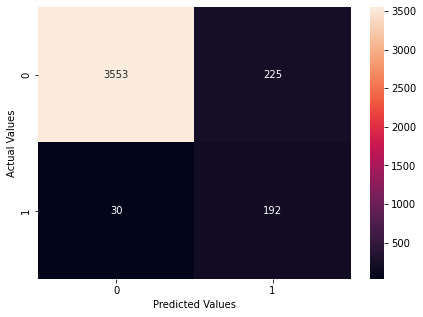

In [534]:
# Confusion matrix for the selected model on test data
cm = confusion_matrix(y_test, bgc3_tuned.predict(X_test))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

In [535]:
# importance of features in the tree building

print(pd.DataFrame(bgc3_tuned.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

     Imp
V18 0.15
V36 0.09
V39 0.09
V14 0.05
V3  0.04
V26 0.04
V15 0.03
V40 0.03
V31 0.03
V16 0.03
V11 0.03
V25 0.03
V12 0.03
V35 0.02
V5  0.02
V20 0.02
V1  0.02
V13 0.02
V9  0.01
V34 0.01
V27 0.01
V8  0.01
V37 0.01
V10 0.01
V38 0.01
V33 0.01
V23 0.01
V24 0.01
V30 0.01
V21 0.01
V4  0.01
V29 0.01
V19 0.01
V7  0.01
V28 0.01
V6  0.01
V2  0.01
V22 0.01
V32 0.01
V17 0.01


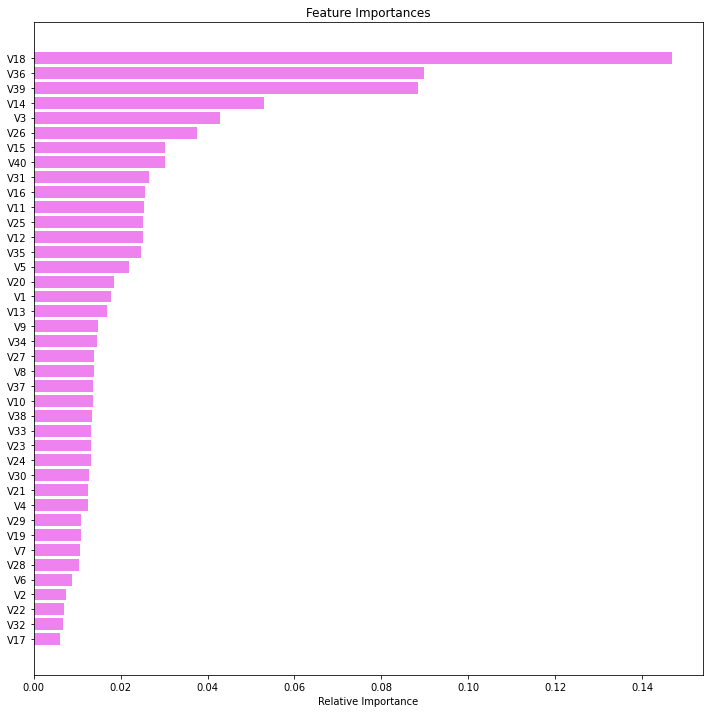

In [536]:
feature_names = X_train.columns
importances = bgc3_tuned.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

* The most likely feature to cause failure based on the selected Gradient Boost model is V18 with a probability of 15%
* Others significant features are V36, V39 with failure probability of 9% each

# Model performance comparison and choosing the final model

In [537]:
# Validation performance comparison

models_val_comp_df = pd.concat(
    [
        dtree_undersampled_model_val_perf.T,
        rf3_tuned_undersampled_model_val_perf.T,
        lgr_undersampled_model_val_perf.T,
        adb_undersampled_model_val_perf.T,
        grb_oversampled_model_val_perf.T,
        xgb_undersampled_model_val_perf.T,
        bgc_tuned_undersampled_model_val_perf.T,
    ],
    axis=1,
)
models_val_comp_df.columns = [
    "Decision Tree with undersampled data",
    "Tuned Random Forest with undersampled data",
    "Logistic Regression with undersampled data",
    "AdaBoost with undersampled data",
    "Gradient Boost with oversampled data",
    "XGBoost with undersampled data",
    "Tuned Bagging Classifier with undersampled data",
]
print("Validation performance comparison:")
models_val_comp_df

Validation performance comparison:


,Decision Tree with undersampled data,Tuned Random Forest with undersampled data,Logistic Regression with undersampled data,AdaBoost with undersampled data,Gradient Boost with oversampled data,XGBoost with undersampled data,Tuned Bagging Classifier with undersampled data
Accuracy,0.92,0.96,0.87,0.89,0.97,0.96,0.95
Recall,0.85,0.92,0.89,0.89,0.90,0.90,0.89
Precision,0.39,0.59,0.29,0.33,0.69,0.59,0.54
F1,0.53,0.71,0.44,0.48,0.78,0.71,0.67


In [538]:
# Test performance comparison

models_test_comp_df = pd.concat(
    [
        dtree_undersampled_model_test_perf.T,
        rf3_tuned_undersampled_model_test_perf.T,
        lgr_undersampled_model_test_perf.T,
        adb_undersampled_model_test_perf.T,
        grb_oversampled_model_test_perf.T,
        xgb_undersampled_model_test_perf.T,
        bgc_tuned_undersampled_model_test_perf.T,
    ],
    axis=1,
)
models_test_comp_df.columns = [
    "Decision Tree with undersampled data",
    "Tuned Random Forest with undersampled data",
    "Logistic Regression with undersampled data",
    "AdaBoost with undersampled data",
    "Gradient Boost with oversampled data",
    "XGBoost with undersampled data",
    "Tuned Bagging Classifier with undersampled data",
]
print("Test performance comparison:")
models_test_comp_df

Test performance comparison:


,Decision Tree with undersampled data,Tuned Random Forest with undersampled data,Logistic Regression with undersampled data,AdaBoost with undersampled data,Gradient Boost with oversampled data,XGBoost with undersampled data,Tuned Bagging Classifier with undersampled data
Accuracy,0.91,0.95,0.86,0.88,0.96,0.94,0.94
Recall,0.84,0.87,0.86,0.86,0.86,0.87,0.86
Precision,0.35,0.52,0.26,0.31,0.63,0.49,0.46
F1,0.50,0.65,0.41,0.45,0.73,0.63,0.60


* The various models are generalizing well and have a good recall scores
* The selected model is the `Gradient Boost with oversampled data` because it has the best combination of recall, accuracy, precision and F1 score

### Test set final performance

In [539]:
test_data.head(3)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
0,-0.61,-3.82,2.20,1.30,-1.18,-4.50,-1.84,4.72,1.21,-0.34,-5.12,1.02,4.82,3.27,-2.98,1.39,2.03,-0.51,-1.02,7.34,-2.24,0.16,2.05,-2.77,1.85,-1.79,-0.28,-1.26,-3.83,-1.50,1.59,2.29,-5.41,0.87,0.57,4.16,1.43,-10.51,0.45,-1.45,0
1,0.39,-0.51,0.53,-2.58,-1.02,2.24,-0.44,-4.41,-0.33,1.97,1.80,0.41,0.64,-1.39,-1.88,-5.02,-3.83,2.42,1.76,-3.24,-3.19,1.86,-1.71,0.63,-0.59,0.08,3.01,-0.18,0.22,0.87,-1.78,-2.47,2.49,0.32,2.06,0.68,-0.49,5.13,1.72,-1.49,0
2,-0.87,-0.64,4.08,-1.59,0.53,-1.96,-0.70,1.35,-1.73,0.47,-4.93,3.57,-0.45,-0.66,-0.17,-1.63,2.29,2.40,0.60,1.79,-2.12,0.48,-0.84,1.79,1.87,0.36,-0.17,-0.48,-2.12,-2.16,2.91,-1.32,-3.00,0.46,0.62,5.63,1.32,-1.75,1.81,1.68,0


In [540]:
final_test = test_data.copy()

In [541]:
# separating the independent and dependent variables
X1_test = final_test.drop(["Target"], axis=1)
y1_test = final_test["Target"]

In [542]:
final_test.isnull().sum()

V1        5
V2        6
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
V29       0
V30       0
V31       0
V32       0
V33       0
V34       0
V35       0
V36       0
V37       0
V38       0
V39       0
V40       0
Target    0
dtype: int64

In [543]:
# Let's impute the missing values
imp_median = KNNImputer(n_neighbors=5)

# fit the imputer on train data and transform the train data
X1_test["V1"] = imp_median.fit_transform(X1_test[["V1"]])
X1_test["V2"] = imp_median.fit_transform(X1_test[["V2"]])

In [544]:
# final test performance of the selected model on the final test data
grb_oversampled_model_final_test_perf = model_performance_classification_sklearn(
    grb1, X1_test, y1_test
)
grb_oversampled_model_final_test_perf

,Accuracy,Recall,Precision,F1
0,0.96,0.85,0.63,0.72


* A recall score of 0.85 indicates that the model is stable 

Text(42.0, 0.5, 'Actual Values')

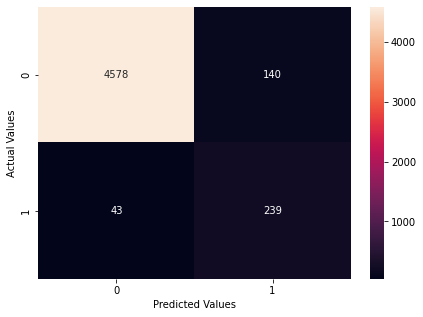

In [545]:
# Confusion matrix for the selected model on test data
cm = confusion_matrix(y1_test, grb1.predict(X1_test))
plt.figure(figsize=(7, 5))
sns.heatmap(cm, annot=True, fmt="g")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

In [546]:
print(pd.DataFrame(grb1.feature_importances_, columns = ["Imp"], index = X1_test.columns).sort_values(by = 'Imp', ascending = False))

     Imp
V36 0.26
V18 0.17
V14 0.09
V39 0.09
V26 0.06
V16 0.05
V9  0.04
V3  0.03
V15 0.02
V12 0.02
V35 0.02
V7  0.01
V10 0.01
V37 0.01
V1  0.01
V34 0.01
V38 0.01
V21 0.01
V27 0.01
V30 0.01
V11 0.01
V33 0.01
V5  0.01
V6  0.00
V13 0.00
V32 0.00
V4  0.00
V17 0.00
V24 0.00
V40 0.00
V2  0.00
V20 0.00
V28 0.00
V22 0.00
V29 0.00
V8  0.00
V31 0.00
V23 0.00
V19 0.00
V25 0.00


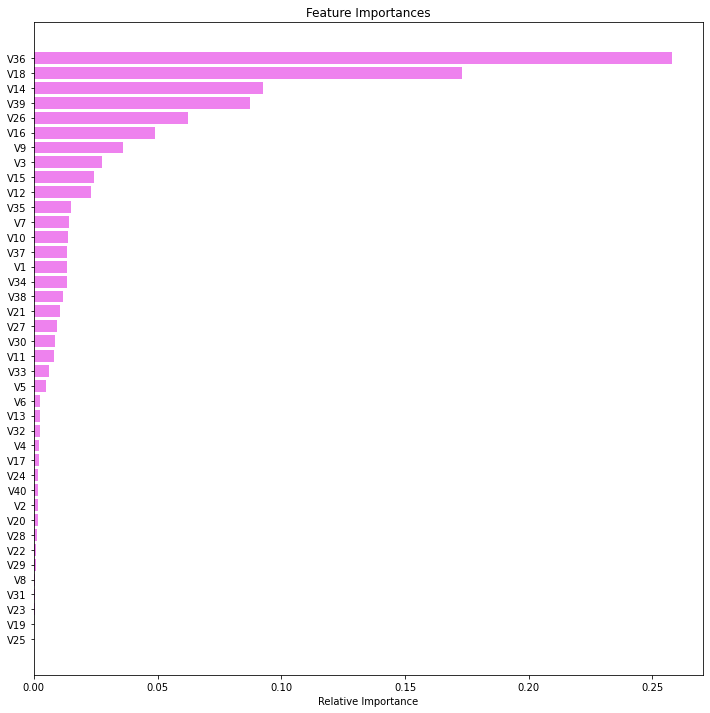

In [547]:
feature_names = X1_test.columns
importances = grb1.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

**Based on the final test data and training data **
* Feature V18 is likely to cause failure with probability of 26%
* Feature V36 is likely to cause failure with probability of 17%
* Features V14 and V39 likely to cause failure with probability of 9% each
* Feature V26 is likely to cause failure with probability of 6%
* Feature V16 is likely to cause failure with probability of 5%
* The other features have less than 4% probability of failure each

## Pipelines to build the final model


In [690]:
df.columns

Index(['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31',
       'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40',
       'Target'],
      dtype='object')

In [700]:
# creating a list of numerical variables
numerical_features = ['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11',
       'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21',
       'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31',
       'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 
       ]

# creating a transformer for numerical variables, which will apply KNN imputer on the numerical variables
numeric_transformer = Pipeline(
    steps=[
        ("imputer", KNNImputer(n_neighbors=5)),
        
    ]
)



In [701]:
preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numerical_features)],
        remainder="passthrough",
        )


In [721]:
# splitting the test and train data
train_X = df.drop(["Target"], axis=1)
train_y = df['Target']

test_X = test_data.drop(["Target"], axis=1)
test_y = test_data['Target']

In [722]:
# Let's impute the missing values
imp = KNNImputer(n_neighbors=5)

# fit the imputer on train data and transform the train data
train_X[['V1','V2']] = imp.fit_transform(train_X[['V1','V2']])


In [724]:
# Synthetic Minority Over Sampling Technique
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
train_X_over, train_y_over = sm.fit_resample(train_X, train_y)

In [726]:
pipe = make_pipeline(preprocessor, GradientBoostingClassifier())
pipe.fit(train_X_over, train_y_over)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   KNNImputer())]),
                                                  ['V1', 'V2', 'V3', 'V4', 'V5',
                                                   'V6', 'V7', 'V8', 'V9',
                                                   'V10', 'V11', 'V12', 'V13',
                                                   'V14', 'V15', 'V16', 'V17',
                                                   'V18', 'V19', 'V20', 'V21',
                                                   'V22', 'V23', 'V24', 'V25',
                                                   'V26', 'V27', 'V28', 'V29',
                                                   'V30', ...])])),
                ('gradientboostingclassifier', GradientBoostingC

In [728]:
Model_test = model_performance_classification_sklearn(pipe, test_X, test_y)
Model_test

,Accuracy,Recall,Precision,F1
0,0.96,0.85,0.63,0.73


# Business Insights and Conclusions

***

* Key predictors of failure such as V18 and V36 should be monitored closely as they are the best predictors of failure
* Others include V14, V39, V26 and V16
* The likelihood of failure increases as V18 values fall below 7.5
* The likelihood of failure increases as V36 values fall below 5
* The likelihood of failure increases as V14 values rise above -4
* The likelihood of failure increases as V39 values fall below 6
* The likelihood of failure increases as V26 values fall below 5
* The likelihood of failure increases as V16 values rise above -10
* Higher quality materials with higher resistance to degradation and wear should be used.
* The frequency of inspection and preventitive maintenance for these parts or components should be increased
* Their fit-for-use parameters should be narrowed